*Project*

David Xiong
(301305081)

Referenced:

*   https://towardsdatascience.com/recurrent-neural-networks-by-example-in-python-ffd204f99470
*   https://www.hackersrealm.net/post/extract-features-from-audio-mfcc-python
*   https://www.datacamp.com/tutorial/tutorial-for-recurrent-neural-network
*   https://www.tensorflow.org/guide/keras/working_with_rnns
*   https://towardsdatascience.com/recurrent-neural-nets-for-audio-classification-81cb62327990


ChatGPT was used to help format code







Install dependencies


In [ ]:
!pip install pandas numpy matplotlib scikit-learn tensorflow librosa

import os
import numpy as np
import librosa
import random
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping


Function to extract mfcc features.
Uncomment out code block to show mfcc as a plot

In [8]:
def extract_mfcc(file_path, n_fft=2048, hop_length=512, max_sequence_length = 680):
    # load audio file and sampling rate
    y, sr = librosa.load(file_path, sr=None)

    # normalize the audio data
    y = y / np.max(np.abs(y))

    # extract MFCC features
    mfccs = librosa.feature.mfcc(y=y, sr=sr, n_fft=n_fft, hop_length=hop_length)

    # normalize the features
    # mfccs = (mfccs - np.mean(mfccs)) / np.std(mfccs)
    mfccs = (mfccs - np.mean(mfccs, axis=1, keepdims=True)) / np.std(mfccs, axis=1, keepdims=True)

    # print(file_path)

    # #uncomment to plot mfcc visually
    # plt.figure(figsize=(10, 4))
    # plt.imshow(mfccs, aspect='auto', origin='lower')
    # plt.title('MFCC Visual Representation')
    # plt.ylabel('MFCC Coefficients')
    # plt.xlabel('Time (seconds)')
    # plt.colorbar(format='%+2.0f dB')

    # # setting the x-axis ticks and labels to print out time as decimals
    # num_frames = mfccs.shape[1]
    # time_values = np.linspace(0, num_frames / 100, num_frames)
    # plt.xticks(np.arange(0, num_frames, 20), [f'{t:.1f}' for t in time_values[::20]])

    # plt.tight_layout()
    # plt.show()

    # pad or truncate sequences to ensure they have the same length
    if max_sequence_length is not None:
        if mfccs.shape[1] < max_sequence_length:
            mfccs = np.pad(mfccs, ((0, 0), (0, max_sequence_length - mfccs.shape[1])), mode='constant')
        elif mfccs.shape[1] > max_sequence_length:
            mfccs = mfccs[:, :max_sequence_length]

    return mfccs


Extract MFCC for training data


In [9]:
############################################## start of file and path processing ##############################################

# reads the csv
# training_data = pd.read_csv("/content/drive/MyDrive/CMPT419/final_project/filtered_training_data.csv")
# uncomment if using direct file path
training_data = pd.read_csv("filtered_training_data.csv")

# remove the .wav in file_name and combine it with chunk so it can read the path in the folders
training_data.loc[:, 'file_name'] = training_data['file_name'].str.replace('.wav', '')
csv_combined_wave_path = training_data['file_name'] + training_data['chunk_name']

# all the wave files in the csv
csv_combined_wave_path = csv_combined_wave_path.tolist()
# print("size of all paths to train: ", len(csv_combined_wave_path), csv_combined_wave_path)

# use a dictionary to store the csv path and the wave path since they are different when using mounted google drive
path_dict = {}
for i in range(len(csv_combined_wave_path)):
  path_dict[csv_combined_wave_path[i]] = "/content/drive/MyDrive/CMPT419/final_project" + csv_combined_wave_path[i]
# print(path_dict)

############################################## end of file and path processing ##############################################

mfcc_train = []

mfcc_train = [extract_mfcc(path_dict[file_path]) for file_path in csv_combined_wave_path]

# can use mfcc_train to train model below
mfcc_train = np.array(mfcc_train)

print("Training MFCC size: ", len(mfcc_train), ", shape:", mfcc_train.shape, "sequence: ", mfcc_train)

np.save('mfccs_train.npy', mfcc_train)


<ipython-input-9-c3e9134a1d84>:9: FutureWarning: The default value of regex will change from True to False in a future version.
  training_data.loc[:, 'file_name'] = training_data['file_name'].str.replace('.wav', '')


Training MFCC size:  2953 , shape: (2953, 20, 680) sequence:  [[[-1.3158836  -1.2866329  -1.3056127  ...  0.          0.
    0.        ]
  [-1.246298   -1.1962367  -1.227824   ...  0.          0.
    0.        ]
  [-0.34904847 -0.19345592 -0.2831256  ...  0.          0.
    0.        ]
  ...
  [ 0.6120153   0.63797367  0.881608   ...  0.          0.
    0.        ]
  [-0.00410033  0.05081832  0.18413876 ...  0.          0.
    0.        ]
  [ 0.9596298   1.0146176   1.0512238  ...  0.          0.
    0.        ]]

 [[-1.0438675  -1.0315278  -1.040387   ...  0.          0.
    0.        ]
  [-1.0462289  -1.0231577  -1.0397621  ...  0.          0.
    0.        ]
  [ 0.06881075  0.14141683  0.08875451 ...  0.          0.
    0.        ]
  ...
  [ 0.84922165  0.76355535  0.80211014 ...  0.          0.
    0.        ]
  [ 0.16945395  0.07497902  0.12363329 ...  0.          0.
    0.        ]
  [ 0.66138804  0.58881     0.632711   ...  0.          0.
    0.        ]]

 [[-1.4487765  -1.4918

Extract MFCC for test data

<ipython-input-7-778d90e7b7ff>:10: FutureWarning: The default value of regex will change from True to False in a future version.
  test_data.loc[:, 'file_name'] = test_data['file_name'].str.replace('.wav', '')


/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_182acf98-9ee6-43ac-8200-1ba71b05ab13/final/chunk10.wav


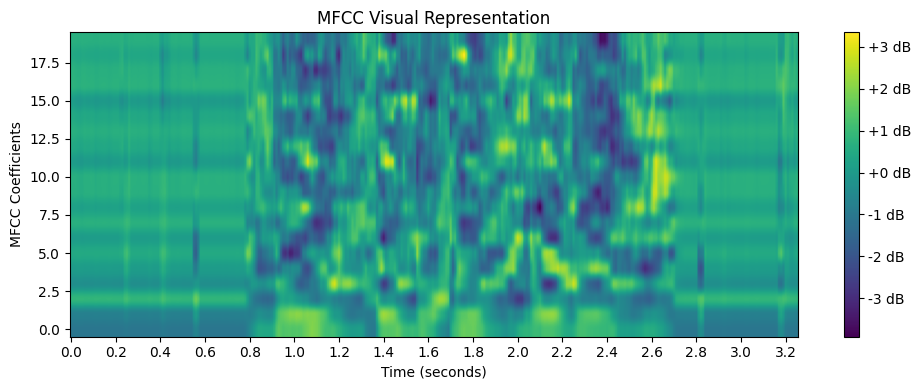

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_28492b1e-a9ff-42fc-801f-75a79fde2051/final/chunk11.wav


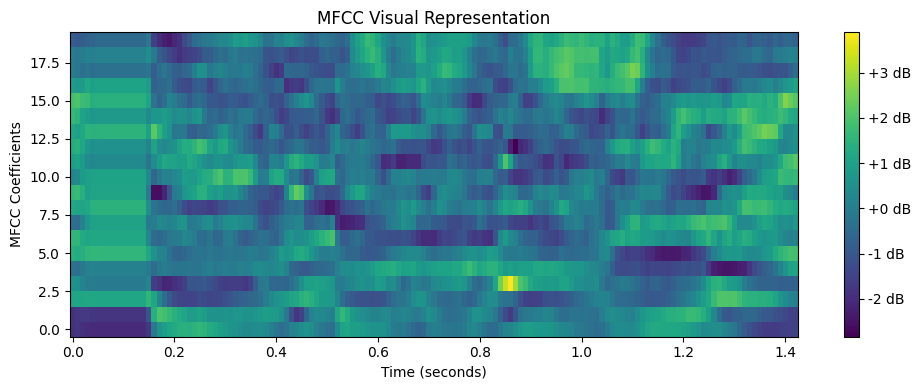

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_19f32cb9-4e31-4773-a9fa-bf135f0e5008/final/chunk00.wav


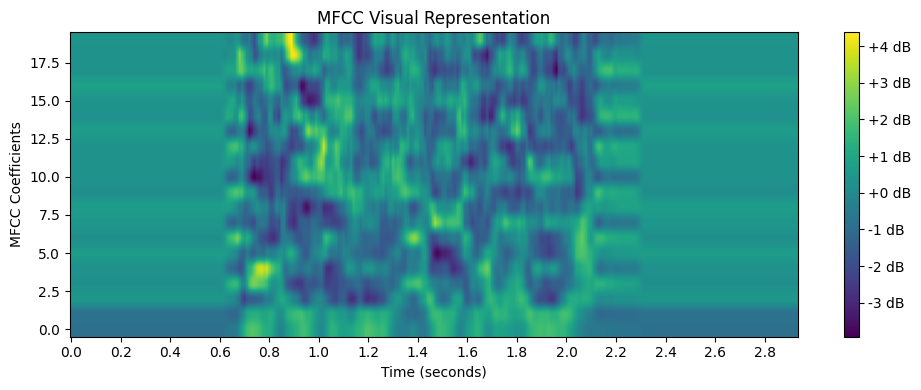

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_44ec8f04-e3c7-43a7-bcd8-631d7e27c86b/final/chunk31.wav


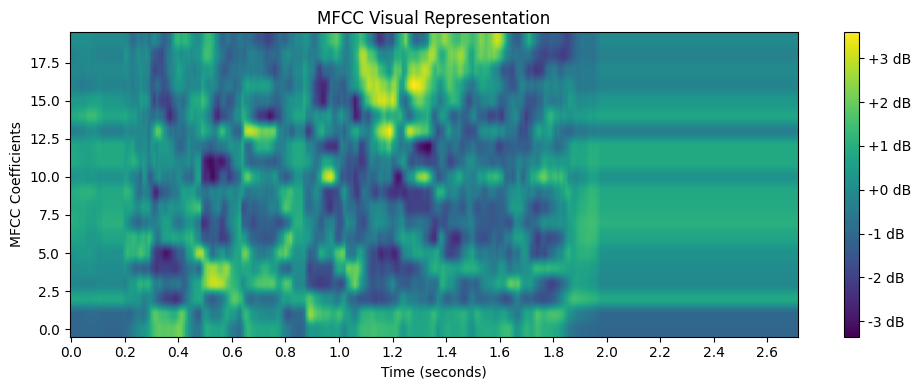

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_8689180c-a74d-4bc5-ae0a-e38b1703b263/final/chunk10.wav


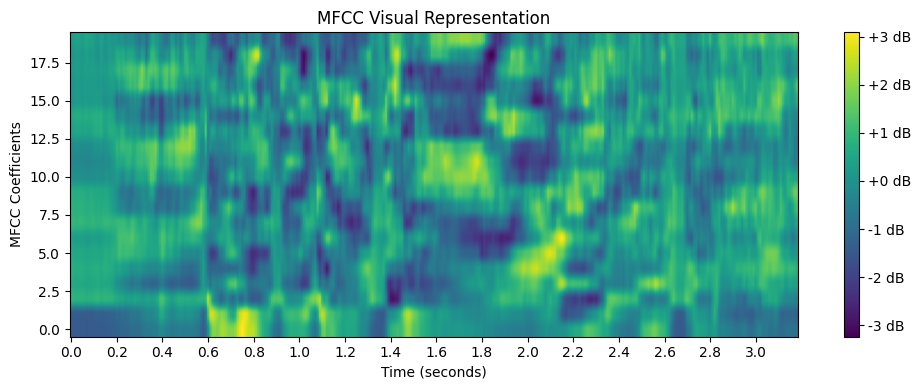

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_3fec94ec-1c01-4ae7-a274-9a57082fcf37/final/chunk10.wav


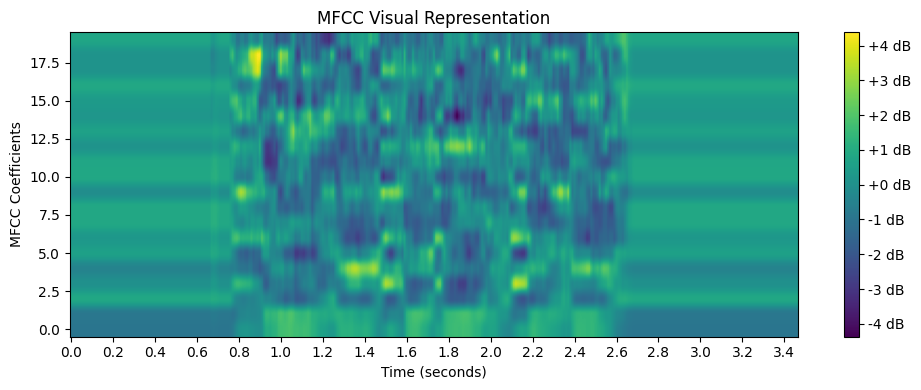

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_b1ec7e42-ba4a-4ba5-91c5-9caa270d800b/final/chunk02.wav


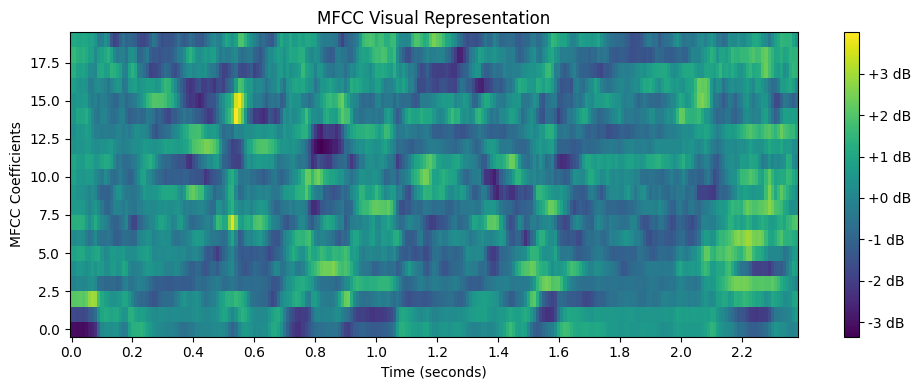

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_87372db0-9d15-4f91-98f0-3dd39270b8fe/final/chunk31.wav


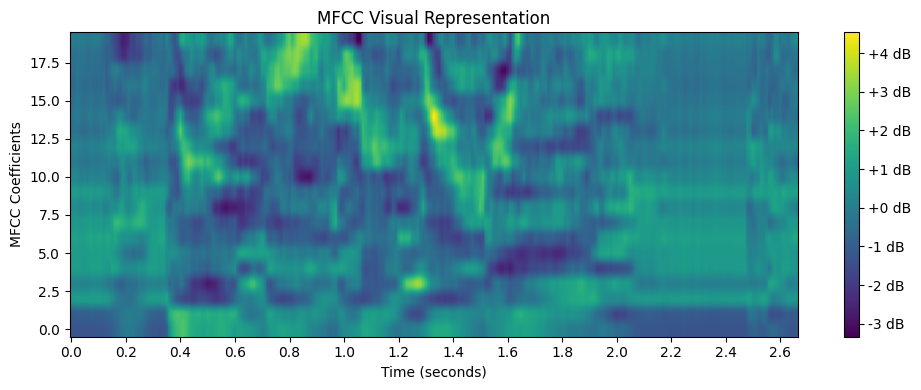

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_a42cdded-70b7-4bcf-a0d3-312eb05c1b8b/final/chunk10.wav


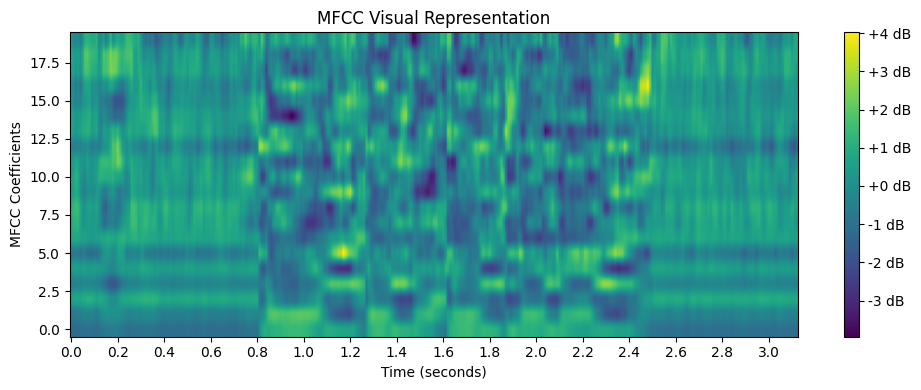

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_9ef1aba0-7273-43d1-8441-9bd3d83dd701/final/chunk23.wav


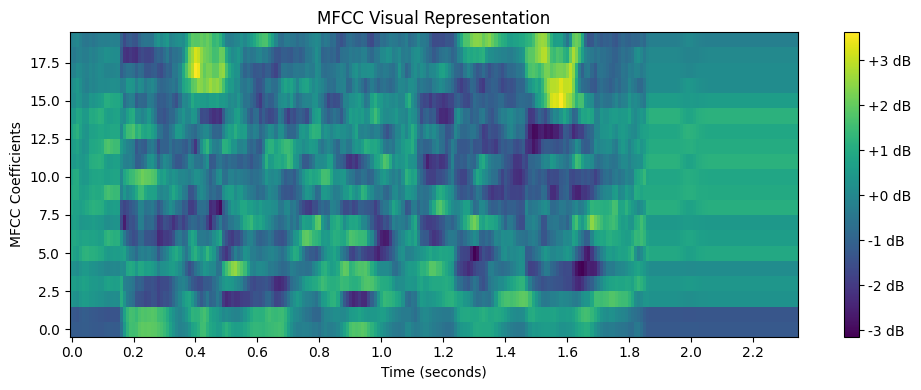

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_9c43e789-eb4d-4546-92b7-1393944dff03/final/chunk01.wav


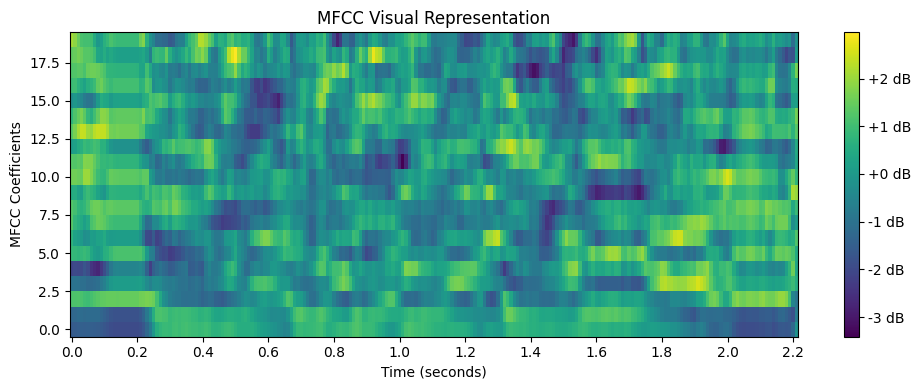

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_f219f017-b03d-4df0-a140-ad2d7e40ad2d/final/chunk30.wav


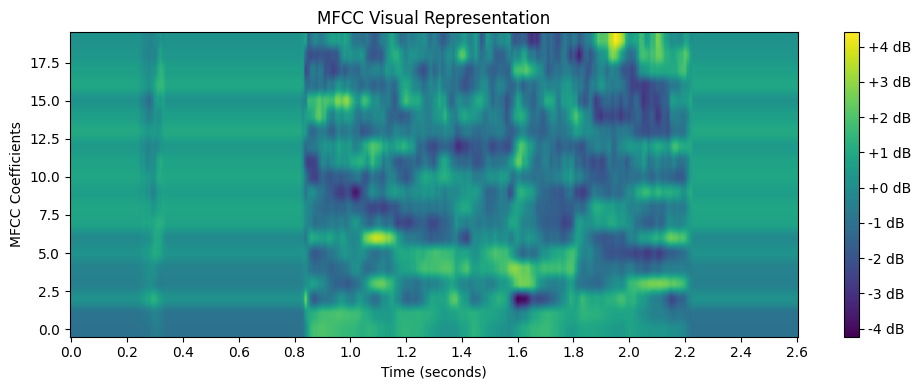

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_096d65c8-7440-4182-9c04-91fd0ec10f8f/final/chunk30.wav


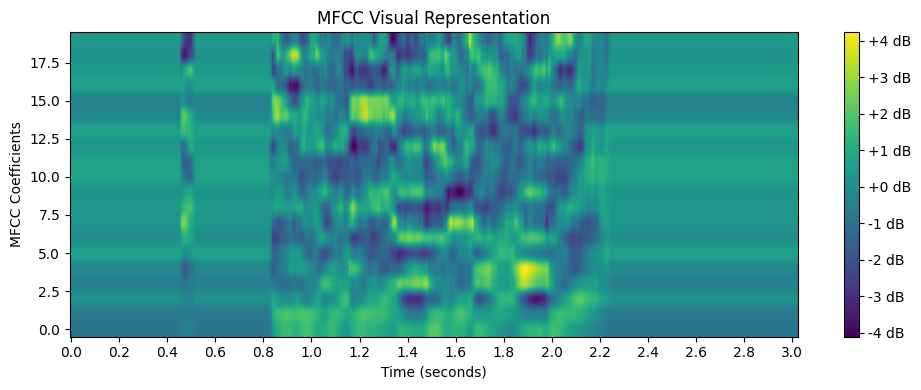

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_3d5babbb-a37a-4724-ac47-ce2900355f57/final/chunk20.wav


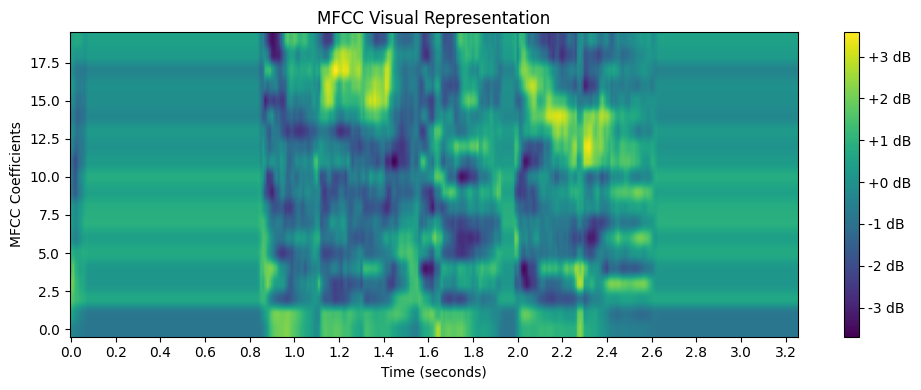

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_d5d4e179-d411-4652-b80b-3bab825694eb/final/chunk01.wav


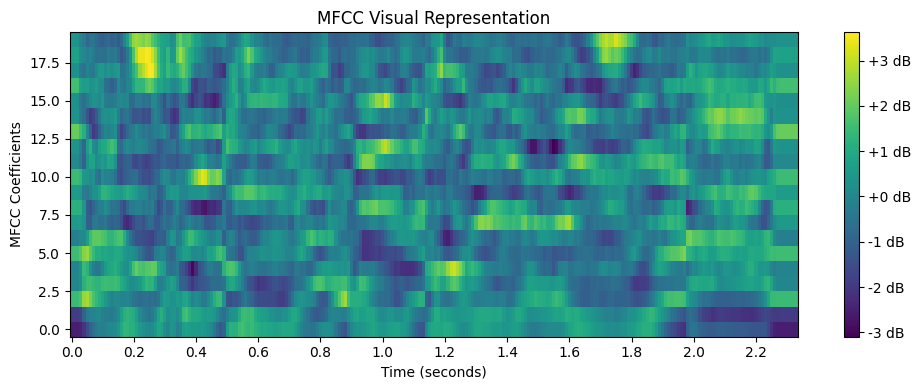

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_ed31b573-cd11-42d1-87d6-1fbc8cae062a/final/chunk50.wav


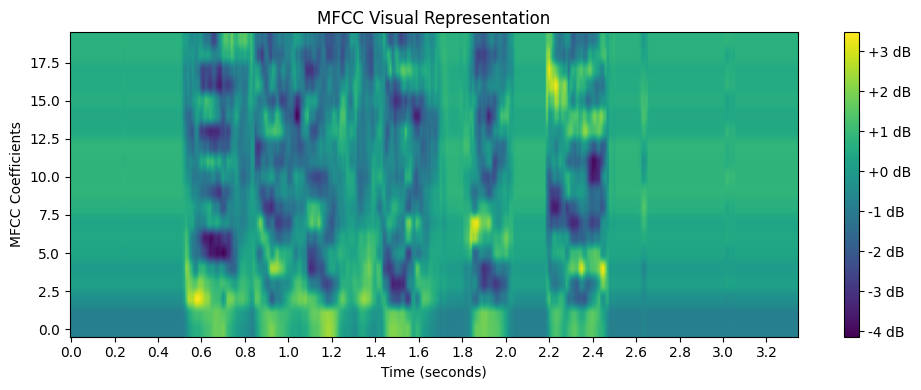

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_1923ddba-aa9d-42fc-b196-8d2ba2f0eee2/final/chunk11.wav


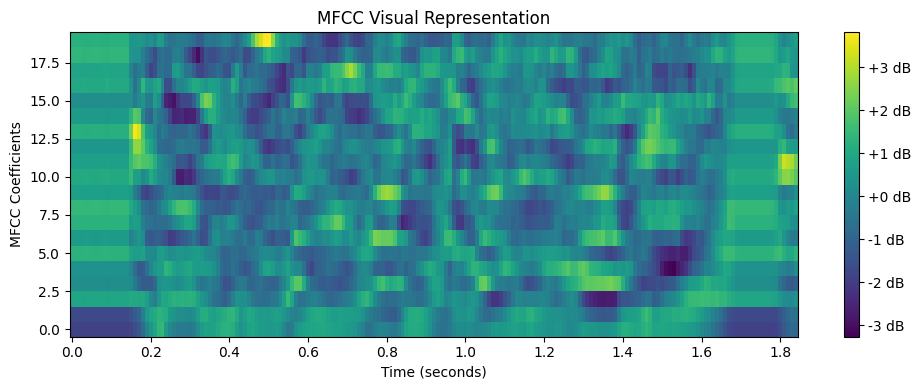

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_eb030df4-e991-427d-970f-bf030d5cfb7b/final/chunk30.wav


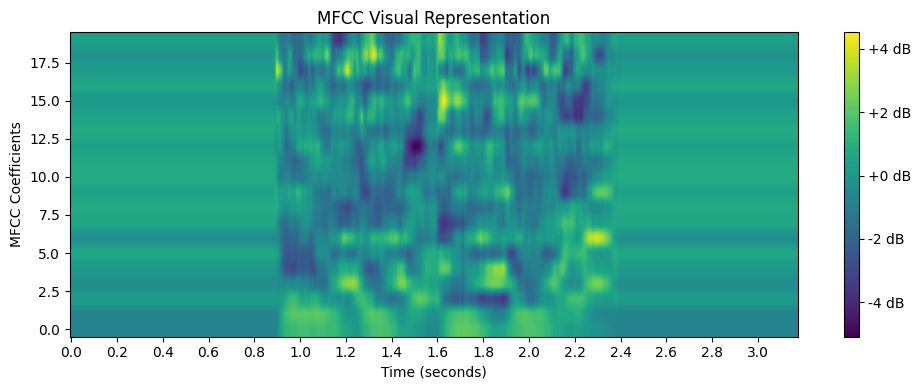

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_53cf7ae5-1d67-4350-8672-1b1c001fb2a1/final/chunk21.wav


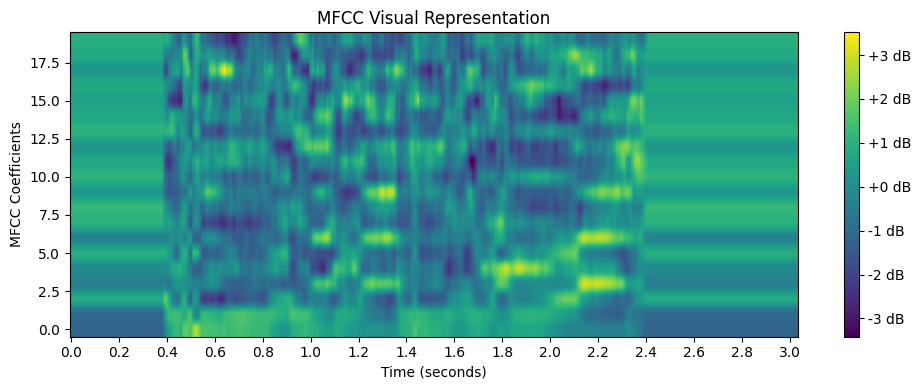

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_12db9d48-3f43-4a20-b801-0b8b4c79be89/final/chunk20.wav


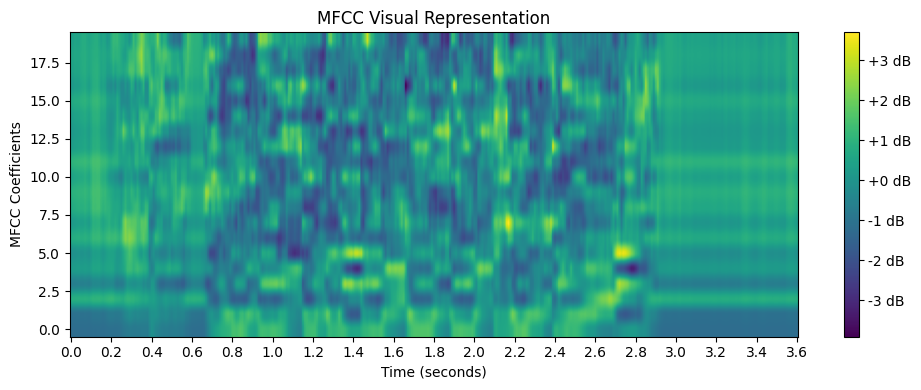

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_abaf5d40-9bca-4cf1-aba3-387eca43ef11/final/chunk30.wav


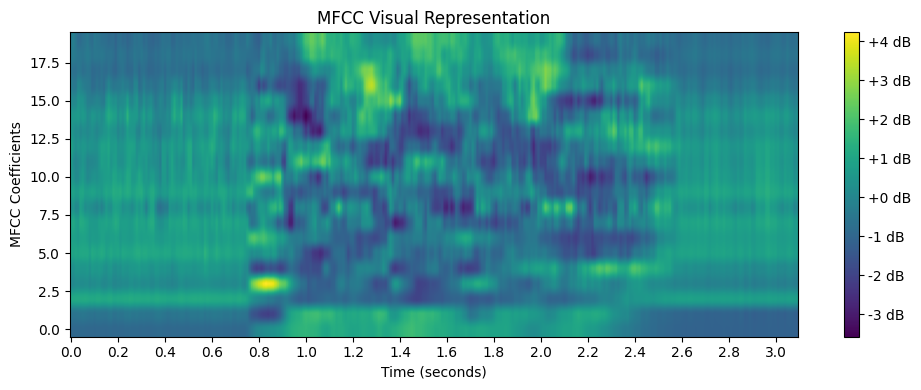

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_00b64a10-e3cd-49b1-b14f-29f5f80ed3b9/final/chunk21.wav


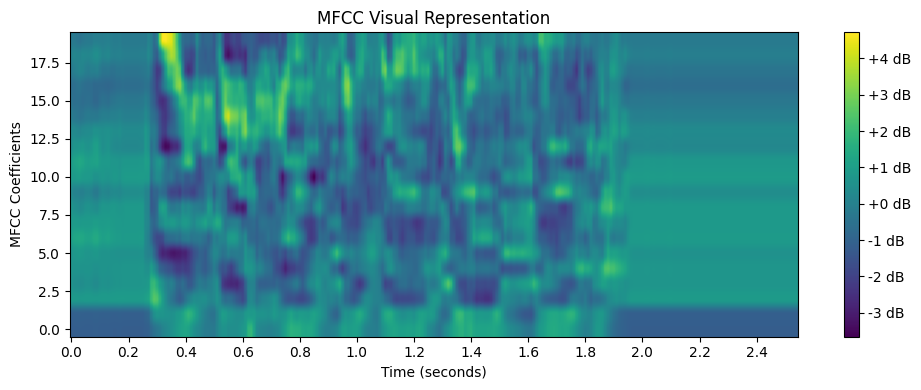

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_bbdc7ff7-c0e5-4a22-9a6b-4ce06969f1bf/final/chunk30.wav


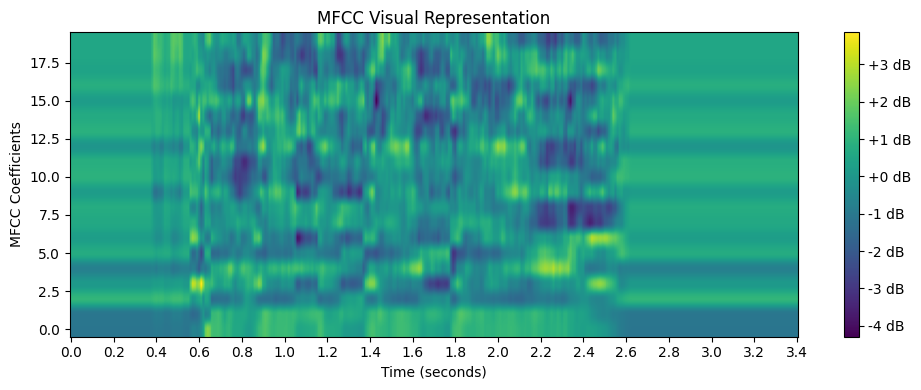

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_02ff6909-0339-45b8-a68f-d0e23a22da49/final/chunk20.wav


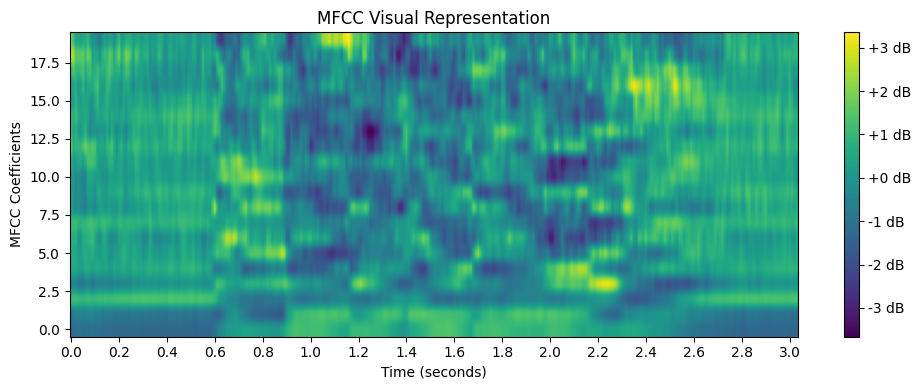

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_27d7be4f-e163-48cd-a82f-e3e3b91d1665/final/chunk00.wav


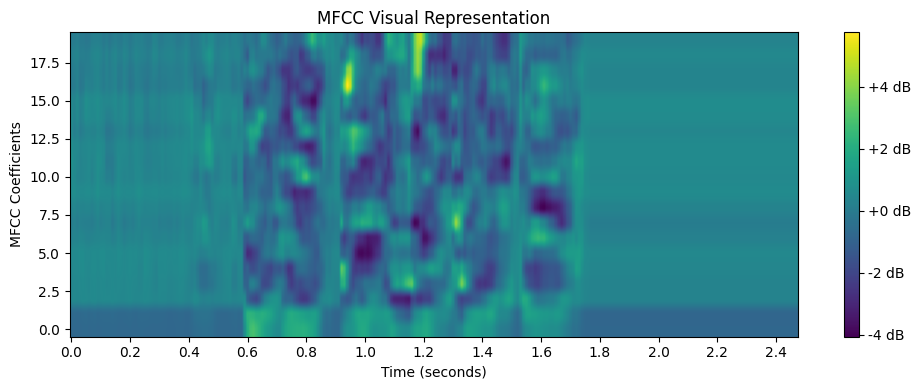

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_a36445ff-64c8-4990-8a66-8f3331cd1245/final/chunk10.wav


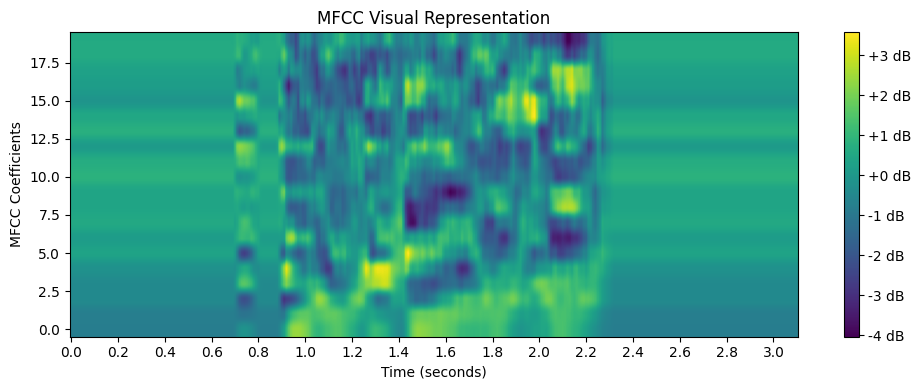

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_c103f85d-a4c1-435b-990b-55721e65618f/final/chunk20.wav


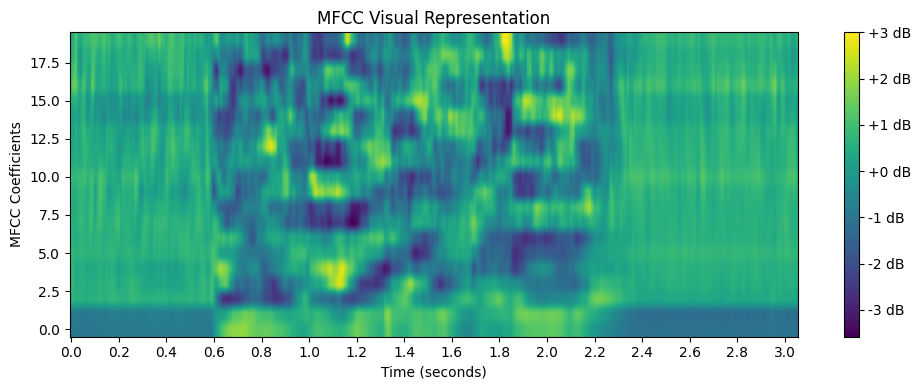

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_d6333794-0248-49d0-82de-3fbc747a9249/final/chunk20.wav


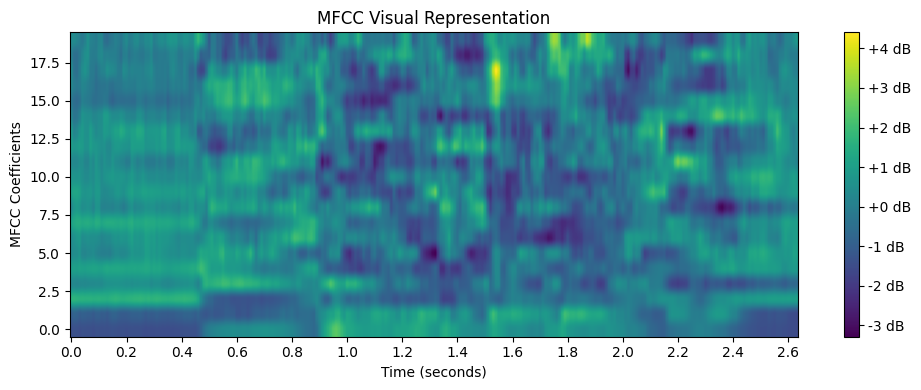

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_ae6feb35-cf7a-4805-8d05-0308c5690010/final/chunk20.wav


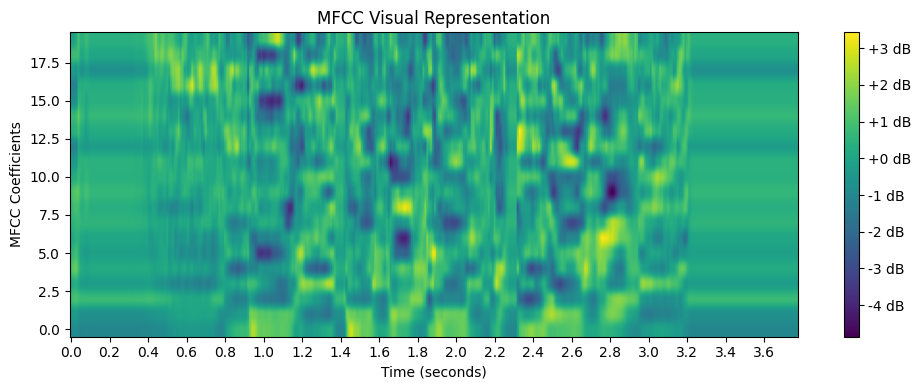

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_fdb758a5-9c86-40f7-8870-ca388b3b0ec0/final/chunk20.wav


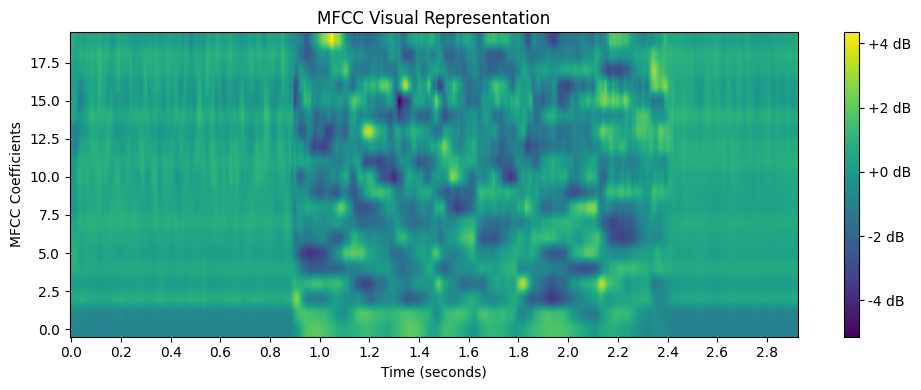

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_dbfb7949-833e-4bd6-a8ee-400e671b2eea/final/chunk21.wav


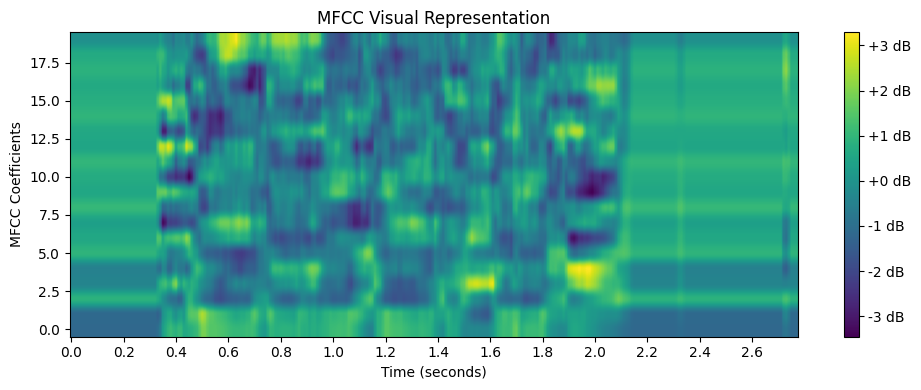

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_10ebbf6b-c075-4c68-9114-aec6a0d27fb9/final/chunk21.wav


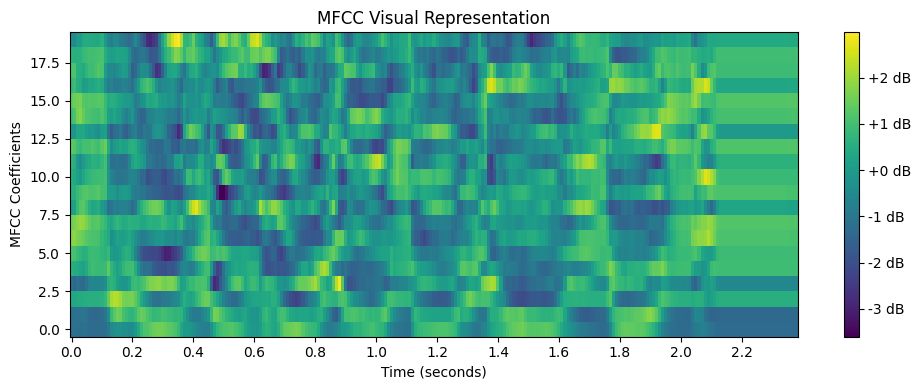

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_68be1fe7-0f7d-4304-954a-de4220117f9c/final/chunk11.wav


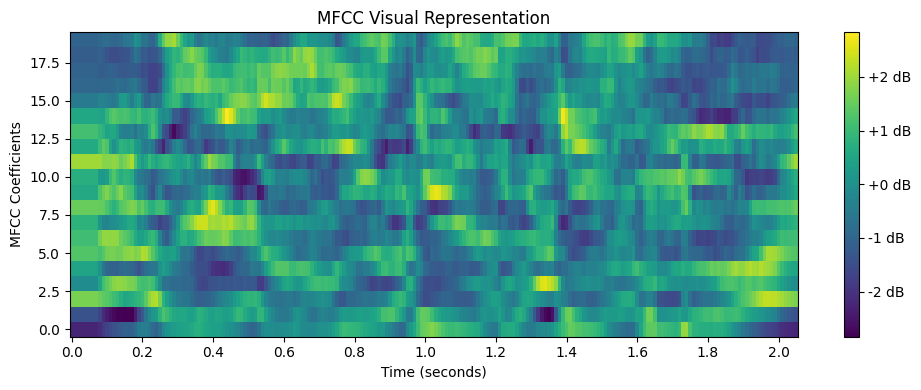

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_684c15d3-926b-4b86-bb22-7f81d1385312/final/chunk21.wav


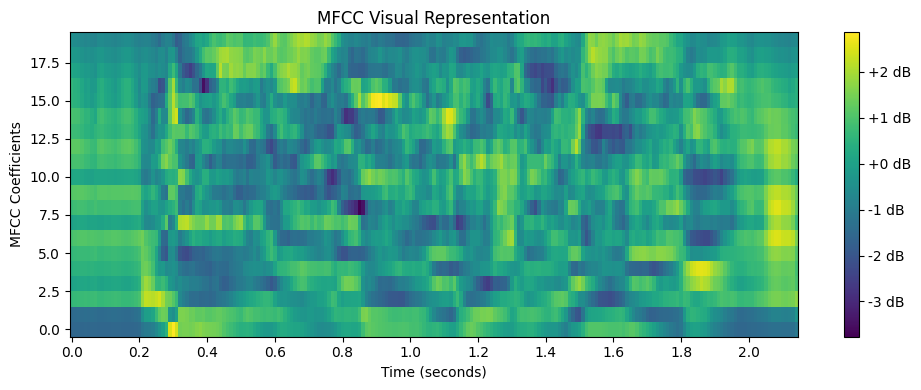

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_7a7dbed3-1b83-489f-9e79-30ea35081fd7/final/chunk20.wav


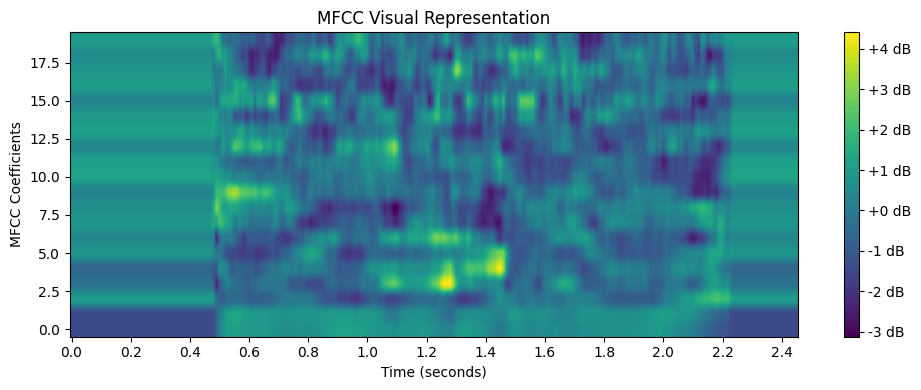

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_a38d1d92-d32d-448a-b3d4-c0f09345af35/final/chunk23.wav


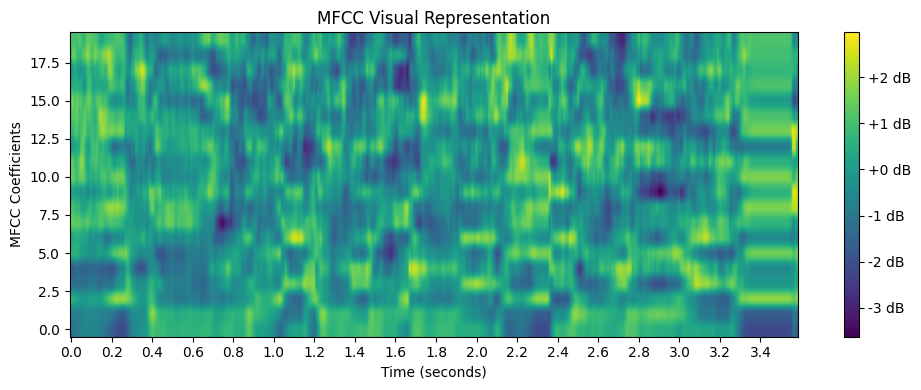

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_b67c0dec-1e67-47a1-80f4-ef915f54c7da/final/chunk11.wav


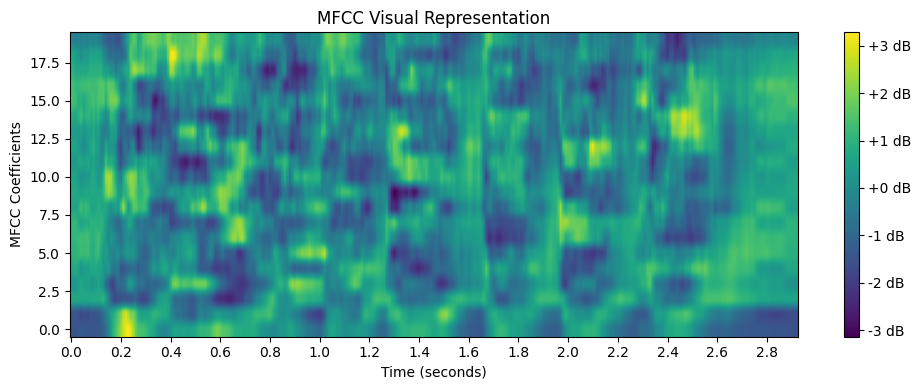

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_8f8c9938-2600-49df-9247-e5a600c7f5fc/final/chunk40.wav


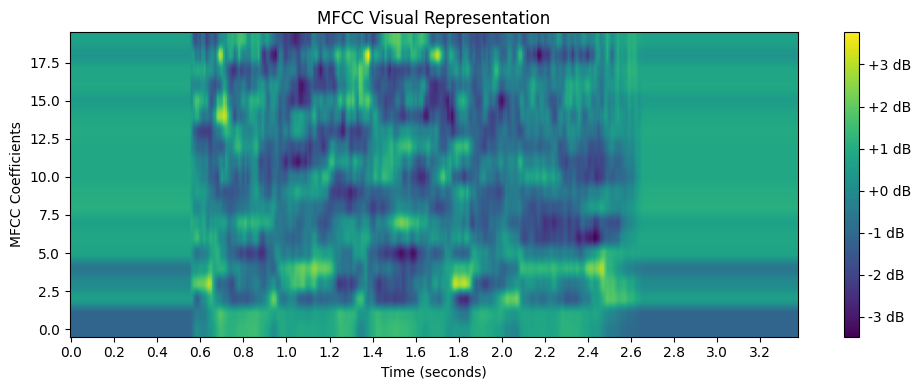

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_09be6a1c-26be-4f58-883b-f0b50a8248c9/final/chunk10.wav


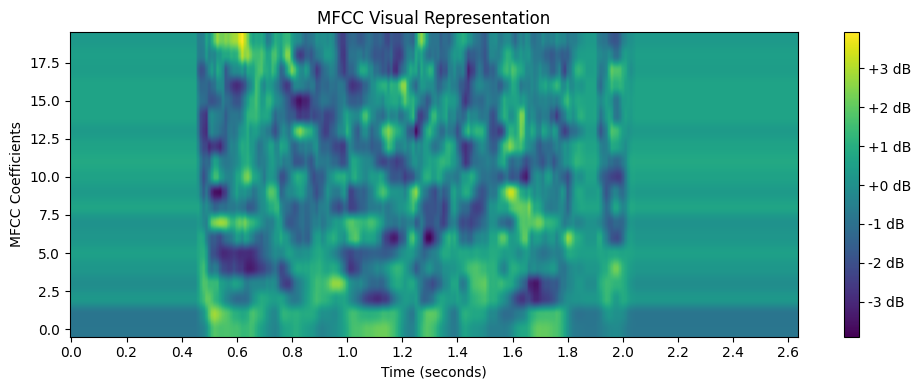

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_fdab99cf-dd78-4cdc-a04a-b01c22e3ff7e/final/chunk40.wav


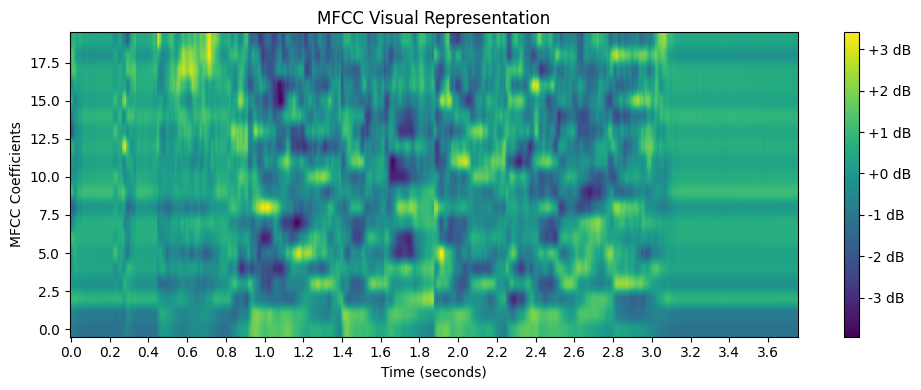

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_300f493f-91bc-44b6-91ab-9fe7dbbbf94b/final/chunk60.wav


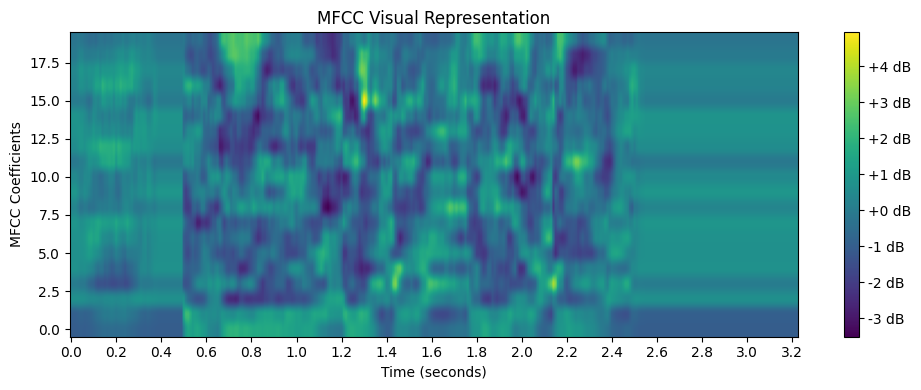

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_456d6828-e2df-42fe-8dfb-4f29aa9c8d63/final/chunk21.wav


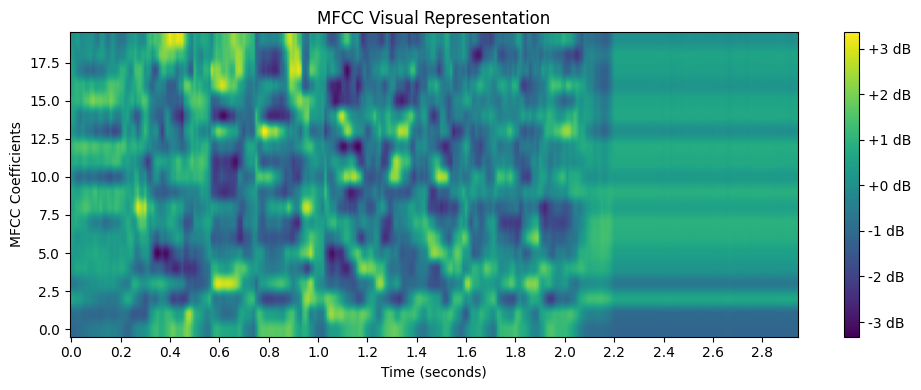

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_09301238-c88f-49cb-98fd-59a99c2b8f6b/final/chunk20.wav


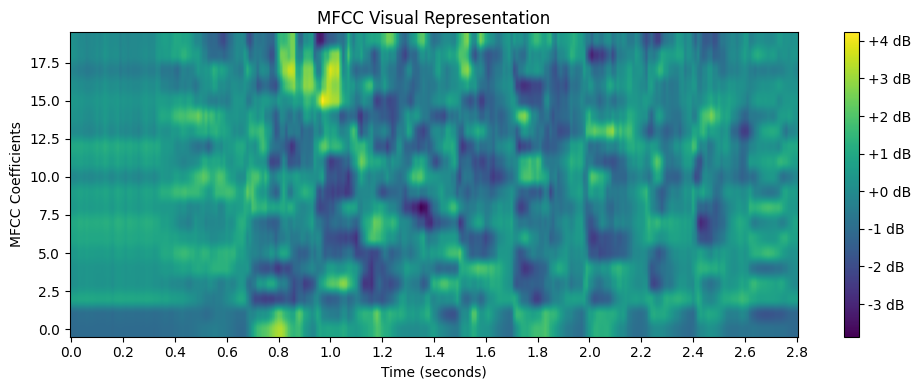

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_59ffbcb1-03cc-4e92-a153-1bf767132bba/final/chunk20.wav


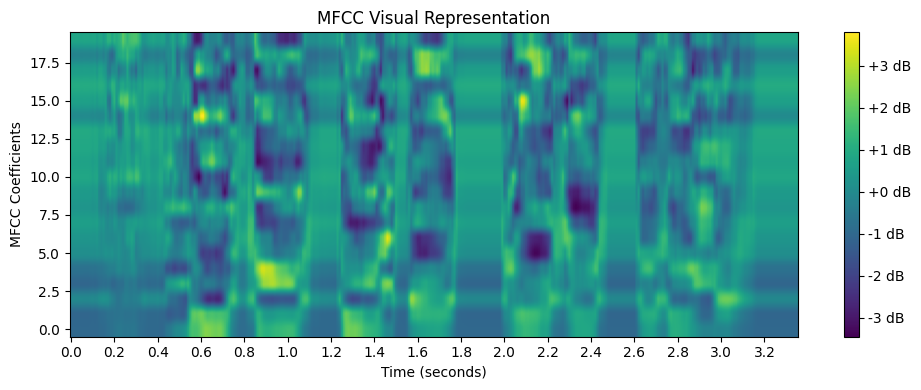

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_1aee309e-1ff8-4219-bff2-ab4a21f77310/final/chunk30.wav


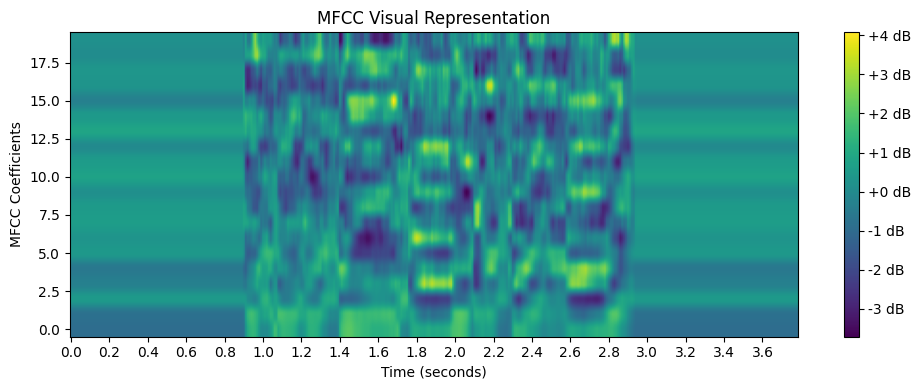

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_6ae0624a-b47b-488a-aa5b-84a10c5ac212/final/chunk11.wav


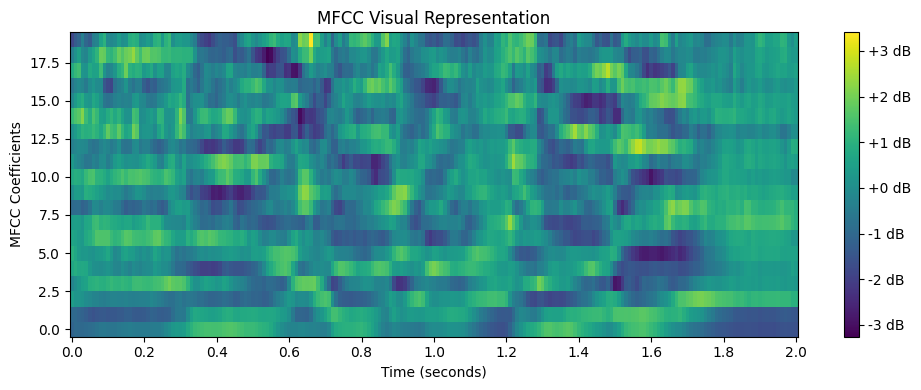

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_62bf4522-7f6f-460b-a7d3-b8f6fb0d058b/final/chunk00.wav


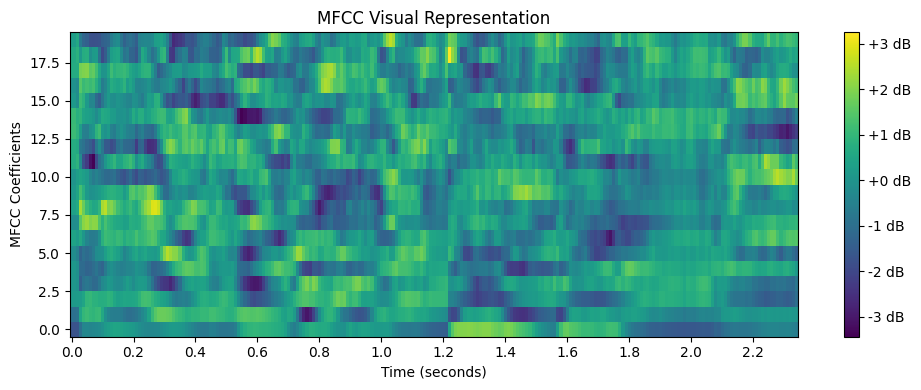

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_3b90f17d-31c1-41a3-b300-af258bbade6b/final/chunk23.wav


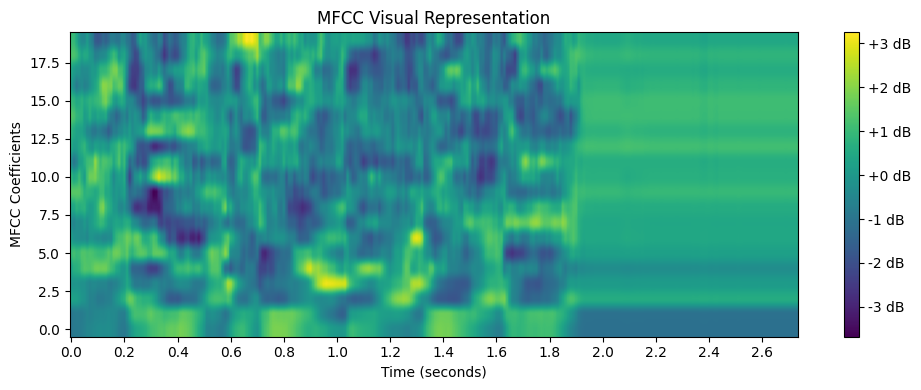

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_38dff1c5-0c6f-45ee-ac39-d844945092f4/final/chunk01.wav


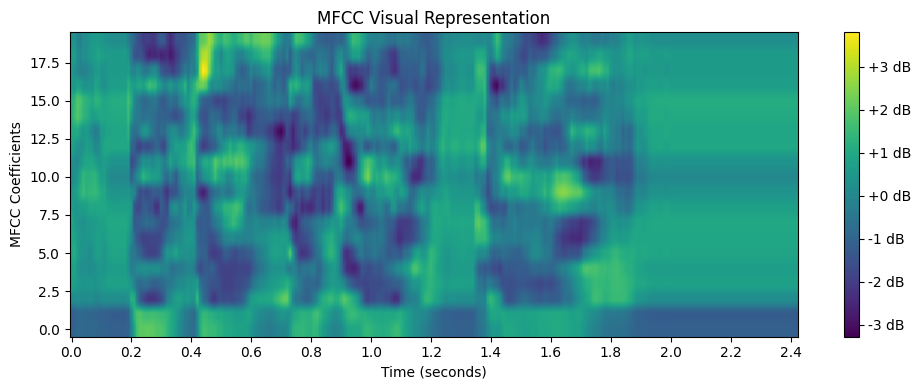

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_490034d0-1843-487f-b820-67a143ab2750/final/chunk30.wav


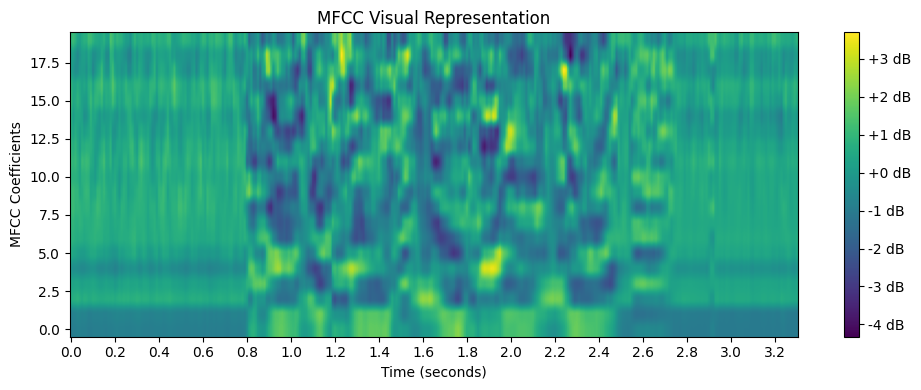

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_712c38a5-cbdc-481e-9177-eefd8849493e/final/chunk20.wav


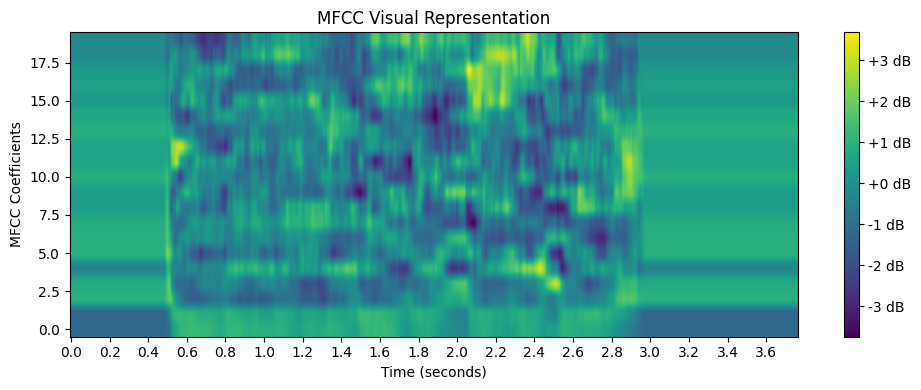

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_94468106-152f-4f28-8456-b7572ce57aa8/final/chunk12.wav


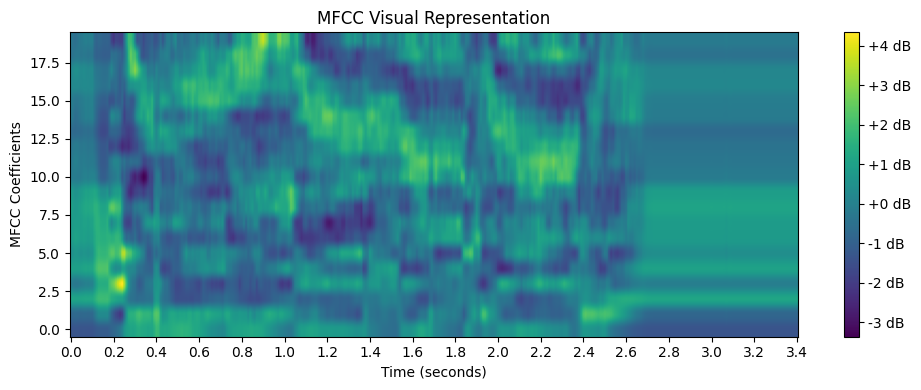

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_a64b053c-4dc5-4776-b1b5-88b5e5945c33/final/chunk11.wav


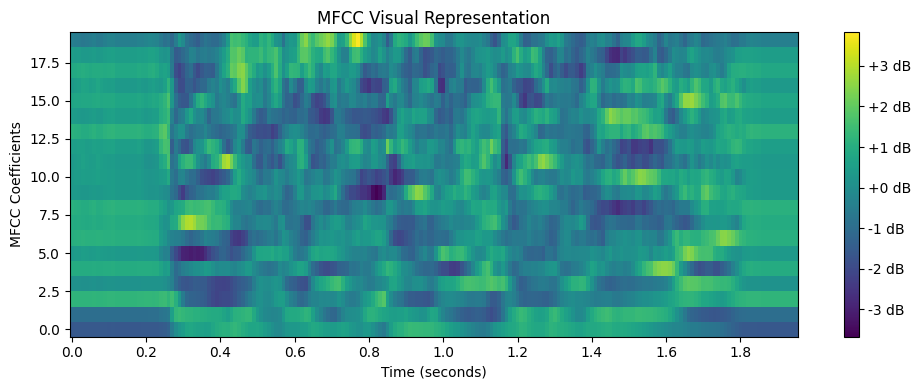

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_0df16d90-8c30-495e-afd3-58aec129a5eb/final/chunk40.wav


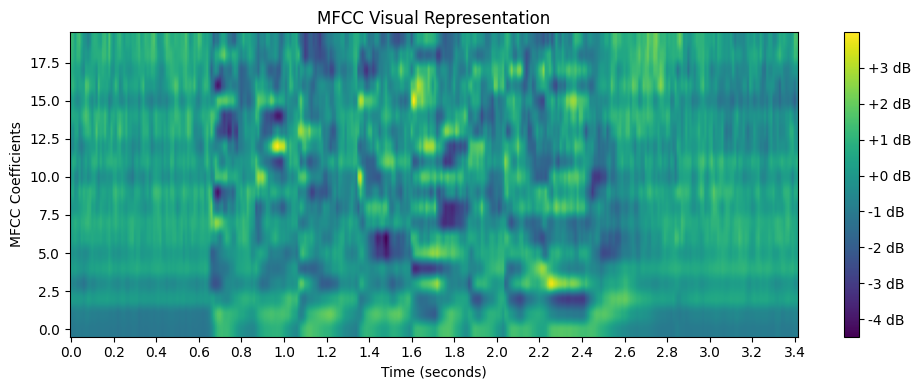

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_0cb6b264-1637-47ad-aa2d-8d3111a18694/final/chunk20.wav


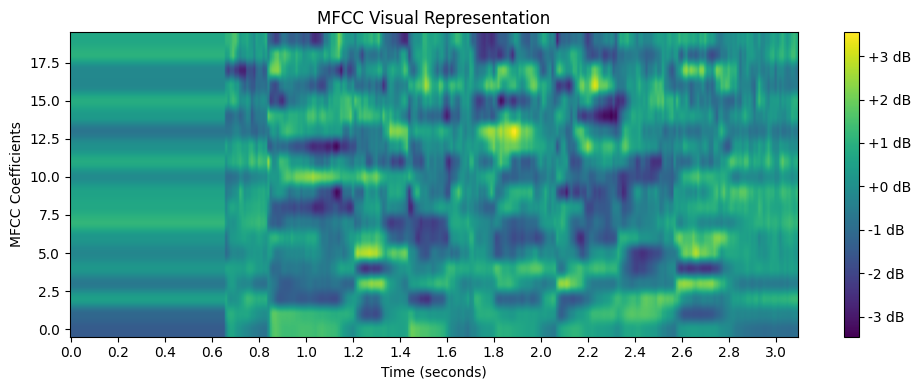

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_809172c4-27e8-4751-86d3-a881d1adf36d/final/chunk11.wav


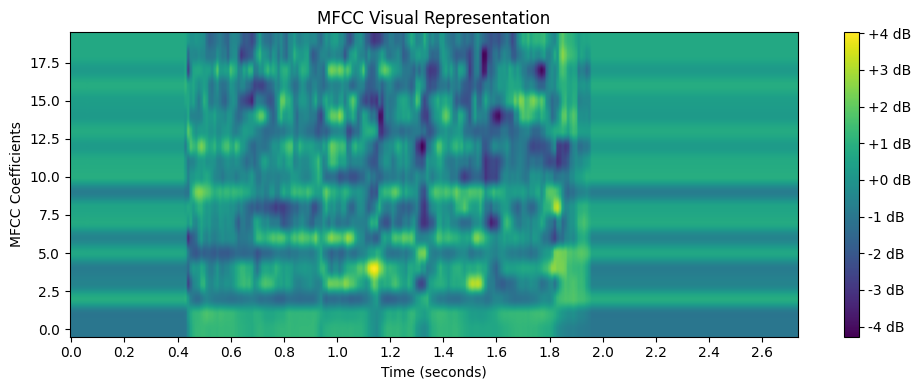

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_c688be59-a5a3-4062-a158-0fbe928f7013/final/chunk30.wav


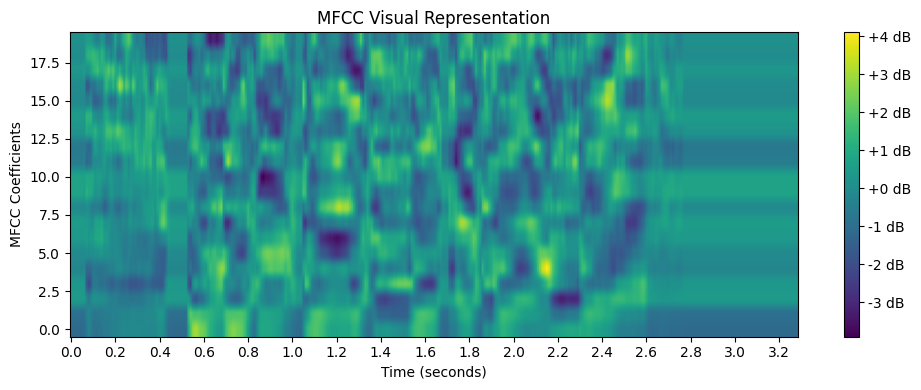

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_811fc4be-d826-4419-a59e-92e2dff78beb/final/chunk31.wav


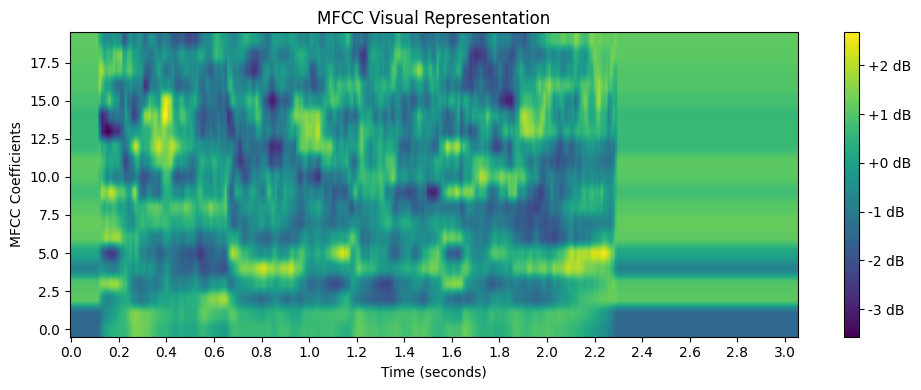

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_34b3165f-b1fe-4647-945c-ffaae7ab1b00/final/chunk20.wav


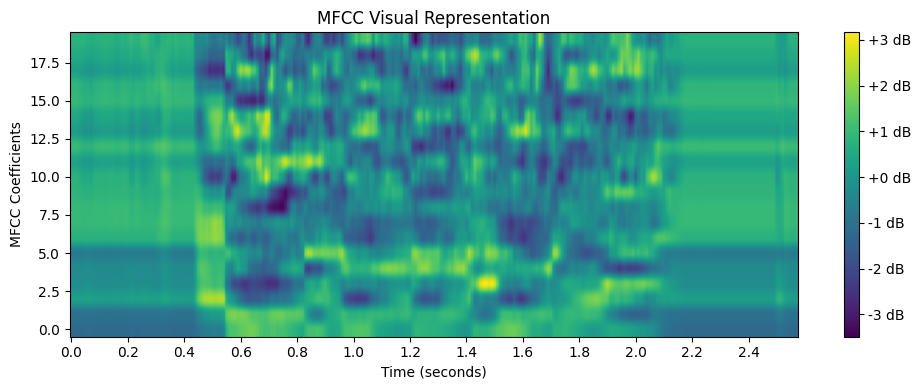

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_1fb9c6ce-07ec-4b55-9d9c-cec43157c7e8/final/chunk22.wav


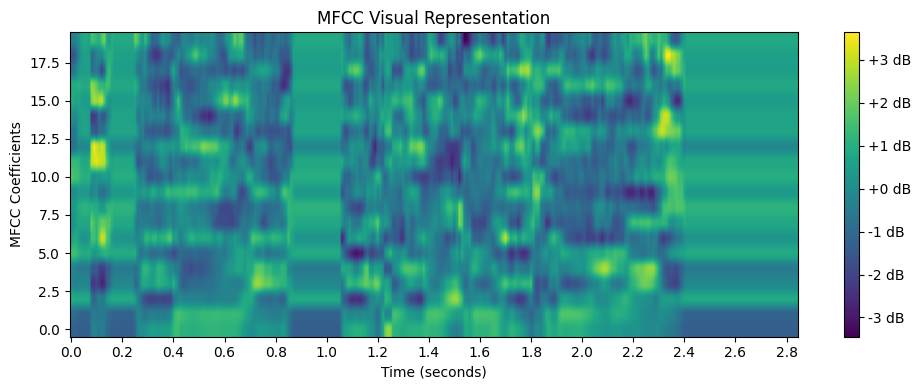

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_cf01b958-b2b3-4be6-9e05-f5c8d6fdc439/final/chunk30.wav


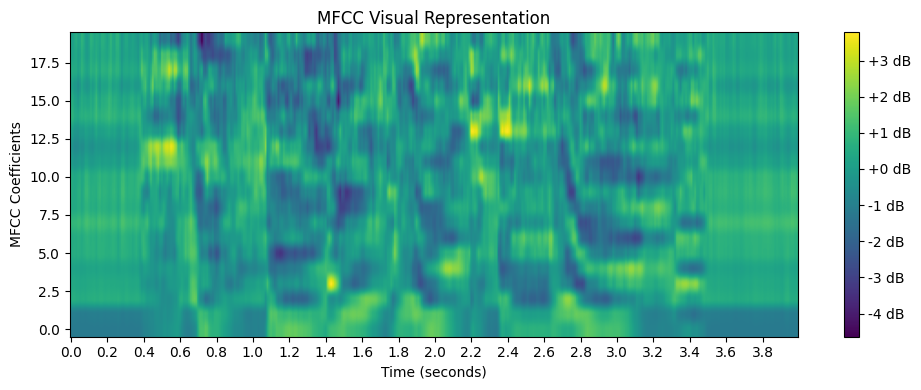

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_93c7c827-8854-44dd-a5f9-68c489f8f82e/final/chunk50.wav


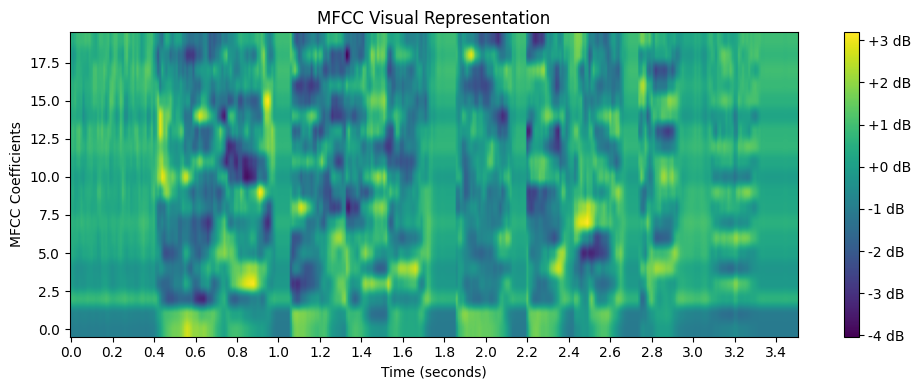

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_fd4aacb1-948d-40f1-97d7-9fb6199bcb04/final/chunk23.wav


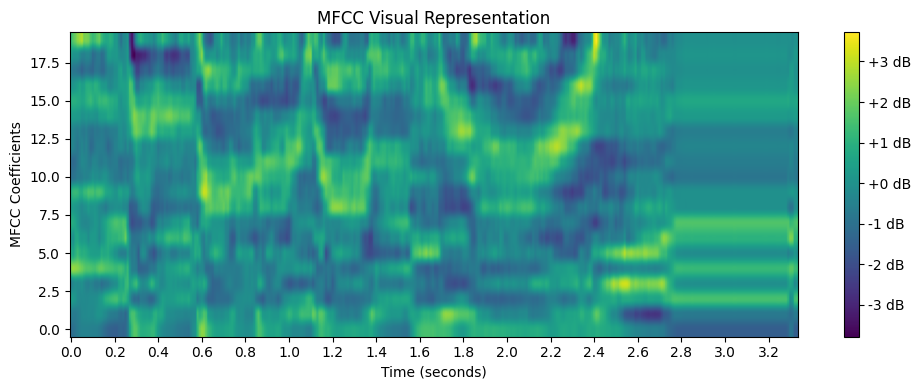

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_8be50cc5-9a40-4b87-89cc-e6c1f92ead8d/final/chunk30.wav


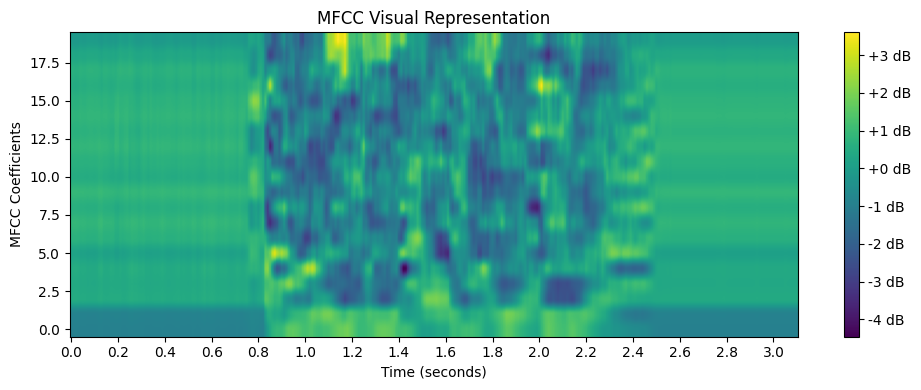

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_33894f82-e4aa-444a-beae-e810588d9133/final/chunk60.wav


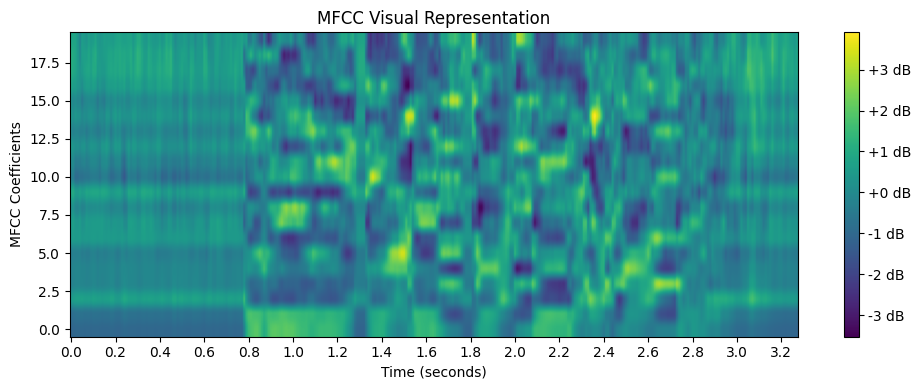

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_73e12c98-3d8b-448f-b49c-3afc0895c98c/final/chunk30.wav


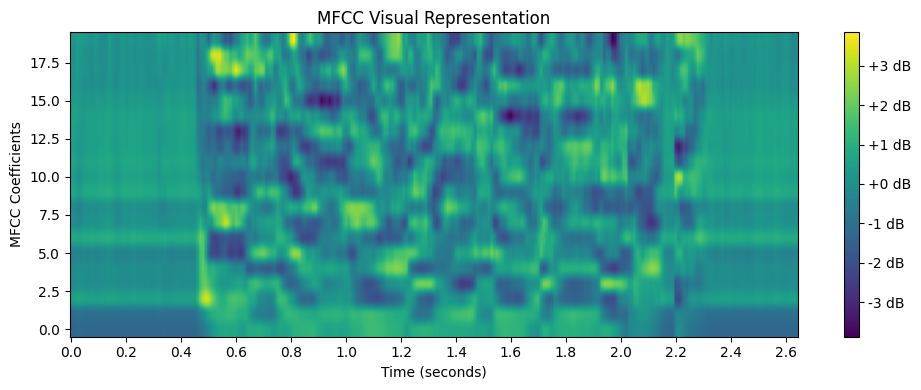

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_cea176cc-129b-4f61-a65d-e845f73ecb41/final/chunk21.wav


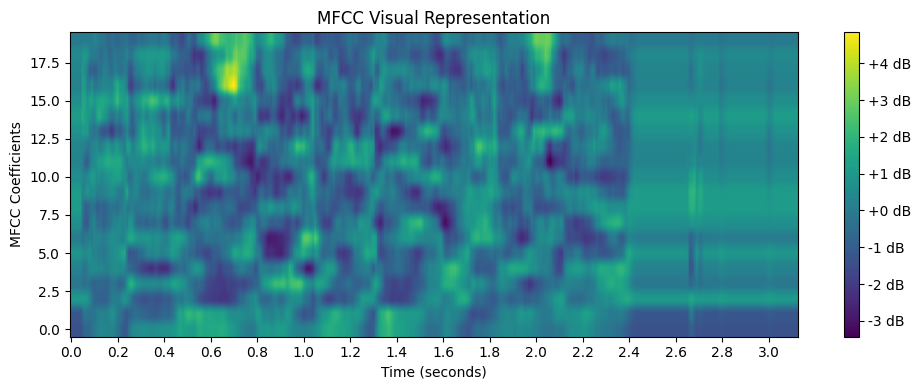

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_3554470d-0bf1-46c4-8660-de62703ce011/final/chunk10.wav


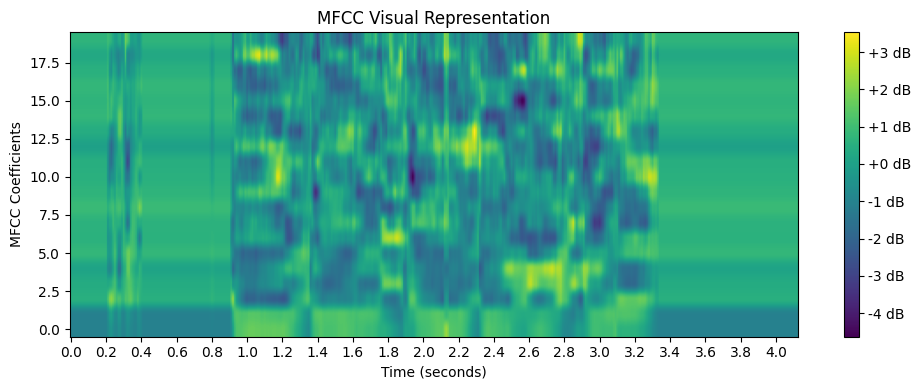

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_c0ef7f09-170b-4763-8853-07aef01afc96/final/chunk20.wav


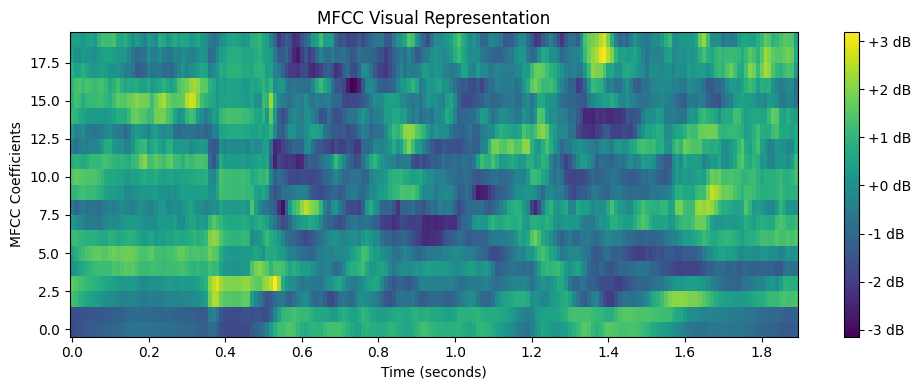

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_0967e48d-4f08-41c2-a6a9-b04ed120e4ee/final/chunk21.wav


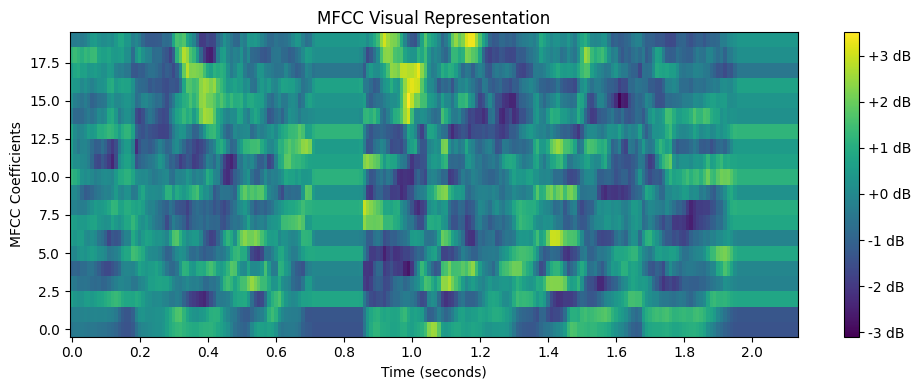

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_5ce30cb2-16cb-4e6d-baf1-867f365bfe57/final/chunk02.wav


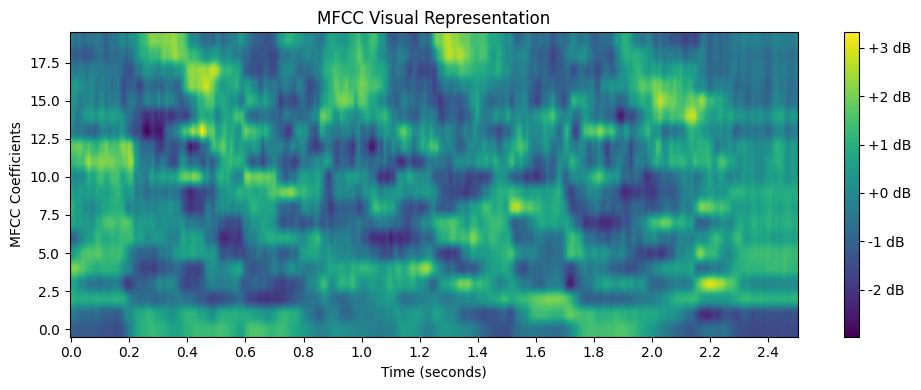

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_fad6cd5b-37c1-4d7a-953d-cb93fbbbaac5/final/chunk41.wav


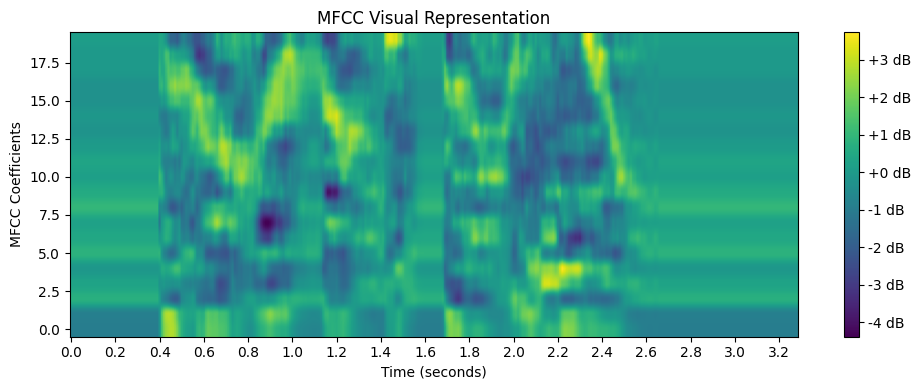

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_733b8275-ed99-48bd-a86a-36e1b720a452/final/chunk00.wav


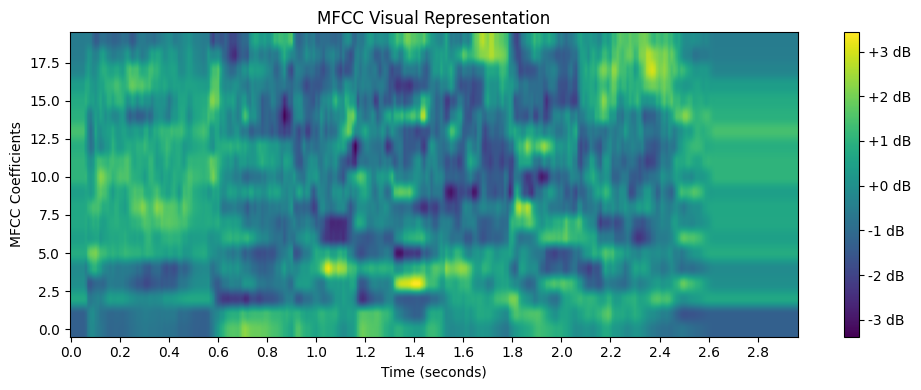

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_cfe80cbb-a720-4022-a376-8fe654a5bd5f/final/chunk10.wav


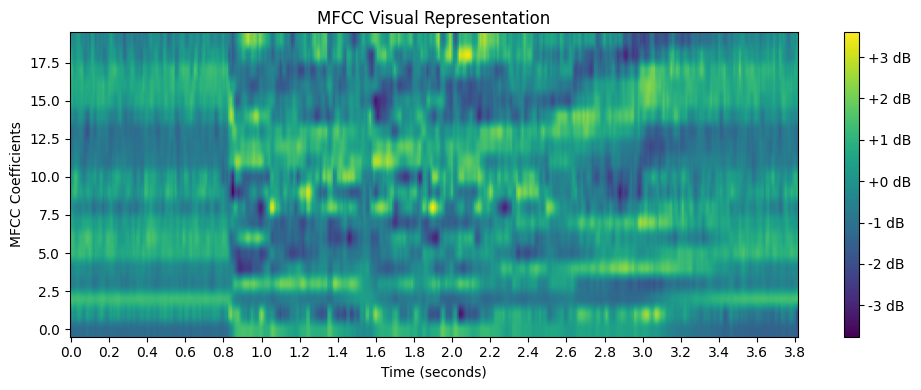

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_7738e236-aabf-4c91-97f7-7a25b4b752d0/final/chunk12.wav


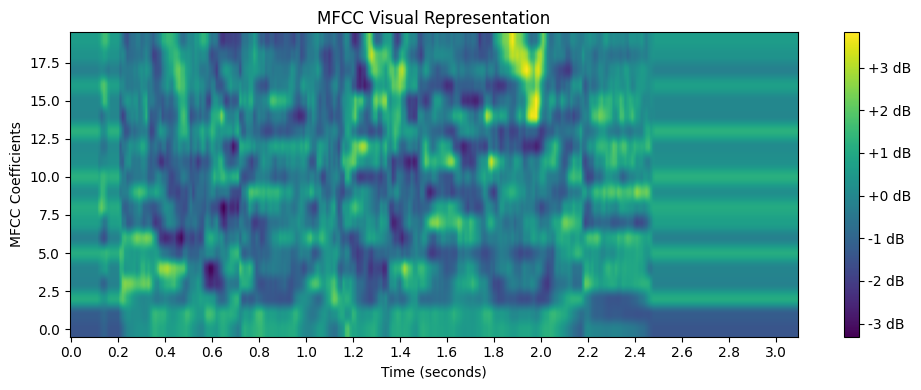

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_9c3712f3-36c8-441e-869d-8b925c5226e6/final/chunk10.wav


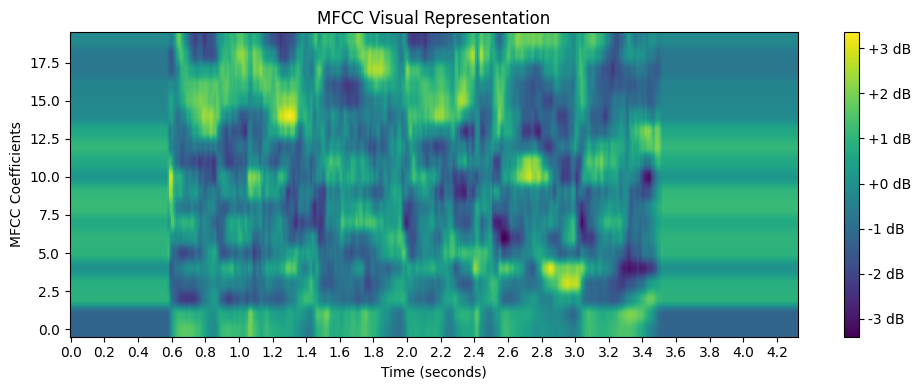

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_b0cac9f6-259d-4f64-9366-26698550ef43/final/chunk10.wav


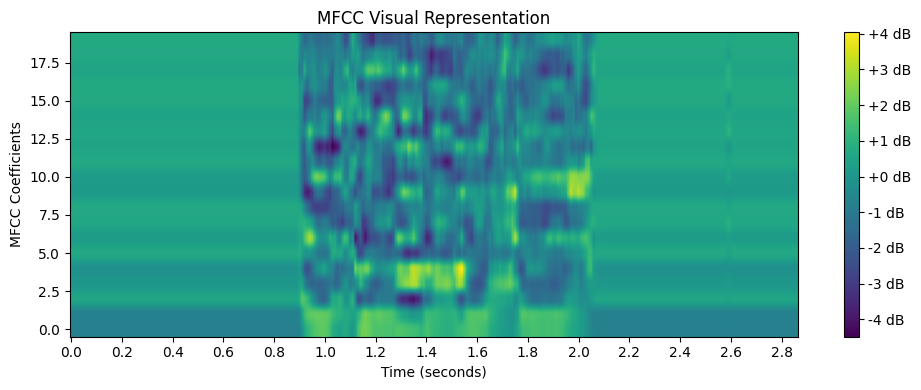

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_49facba0-2acf-486a-87b0-fb972cc92134/final/chunk21.wav


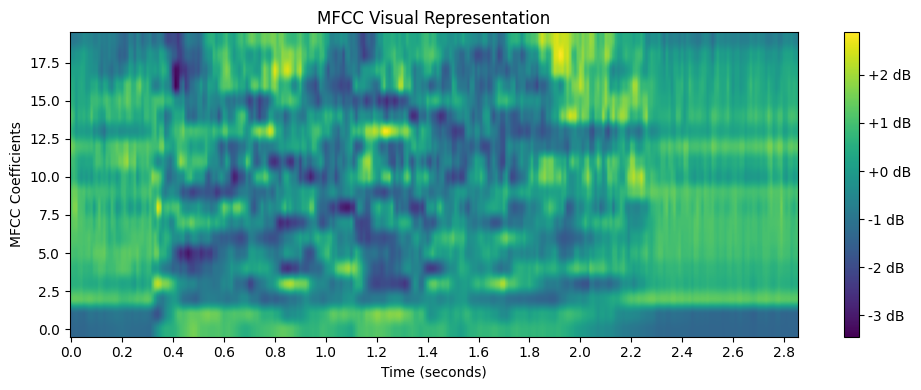

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_74cd50fa-eb3c-49f4-9900-811d880c461f/final/chunk10.wav


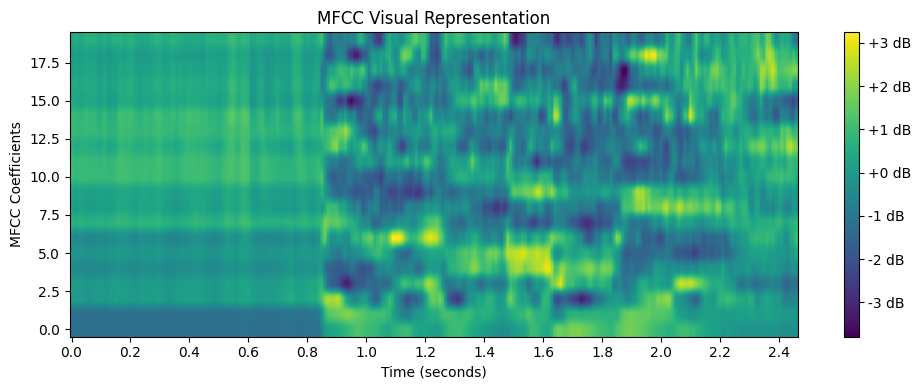

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_0ae34afa-62a0-49cb-ab3a-4d882c2c124b/final/chunk30.wav


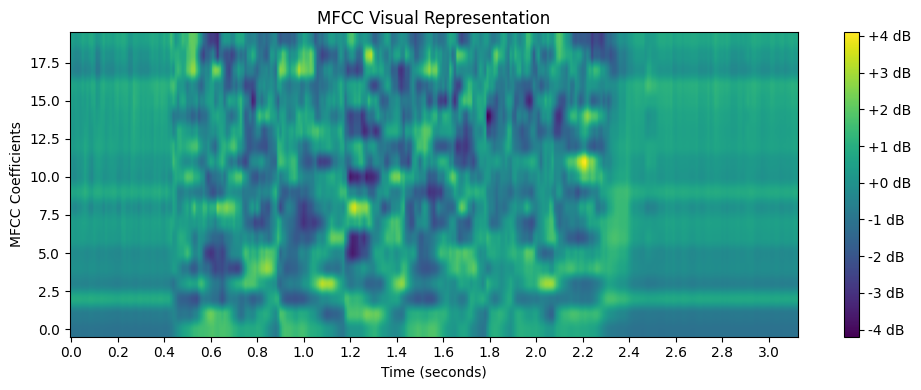

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_648bd37f-022e-4cf5-9532-cbb4bfc0441e/final/chunk41.wav


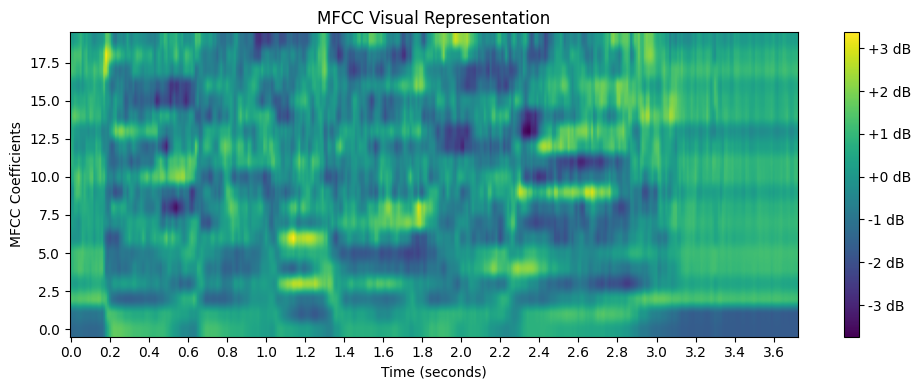

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_a7f8d91d-e2b8-493a-b120-6f64287d0a94/final/chunk21.wav


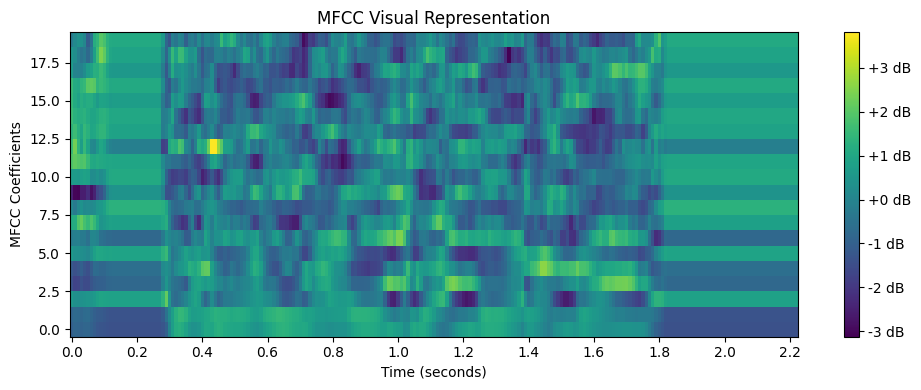

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_f03a201c-28c7-4313-a58f-86adde8f7c03/final/chunk50.wav


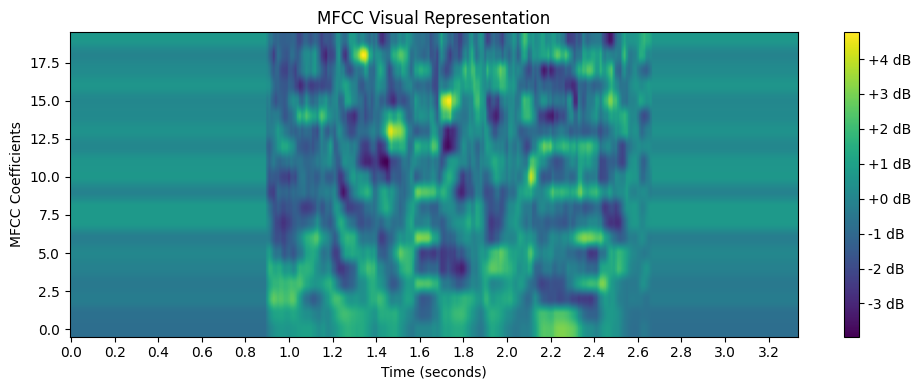

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_4ae9bb30-fc3e-41a6-b4a5-d6bce5a6d496/final/chunk20.wav


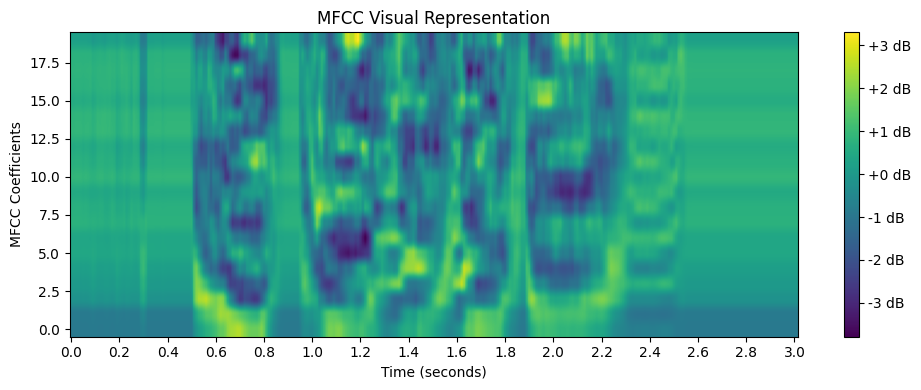

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_073b4050-bae0-483b-95f7-e7dd33bba414/final/chunk61.wav


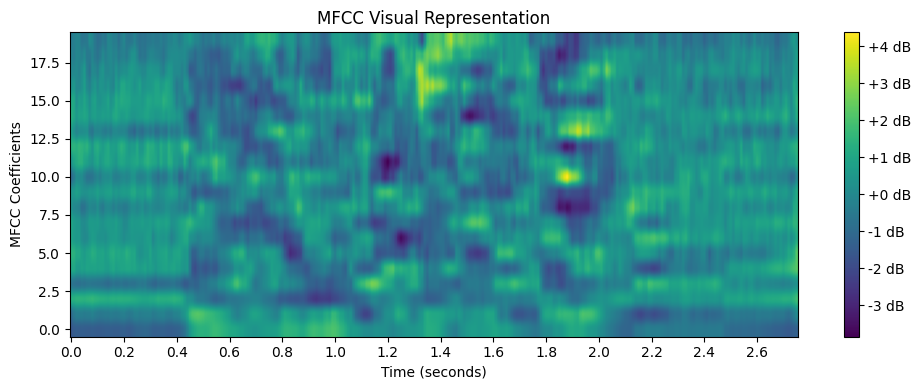

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_f1541770-7299-4dfd-bc24-cad71789c2e9/final/chunk00.wav


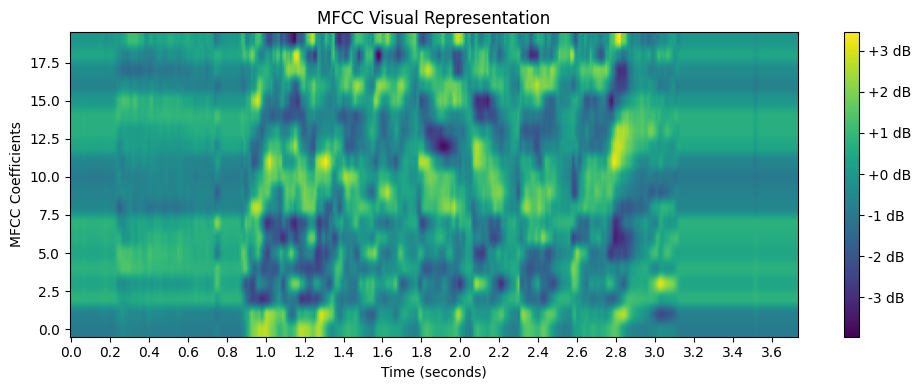

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_bbb2450d-2cc3-4cc8-a921-c46154d4f05b/final/chunk13.wav


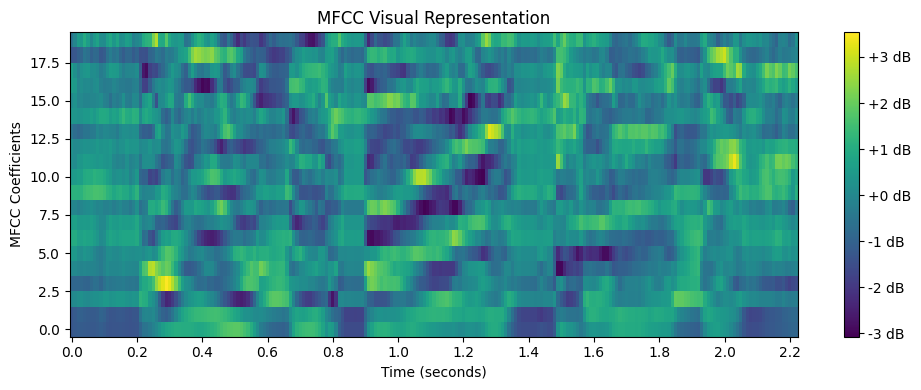

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_6b44458f-28c2-466e-8d11-144f96d154e3/final/chunk51.wav


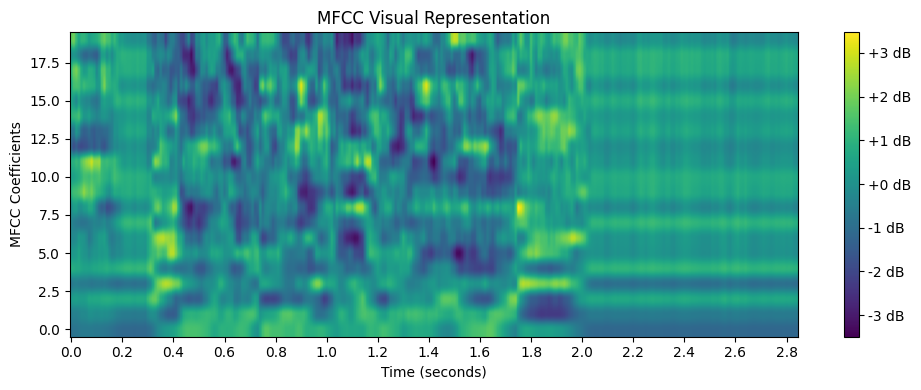

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_937ac6ba-05b3-4752-922a-b9eff7d10cda/final/chunk40.wav


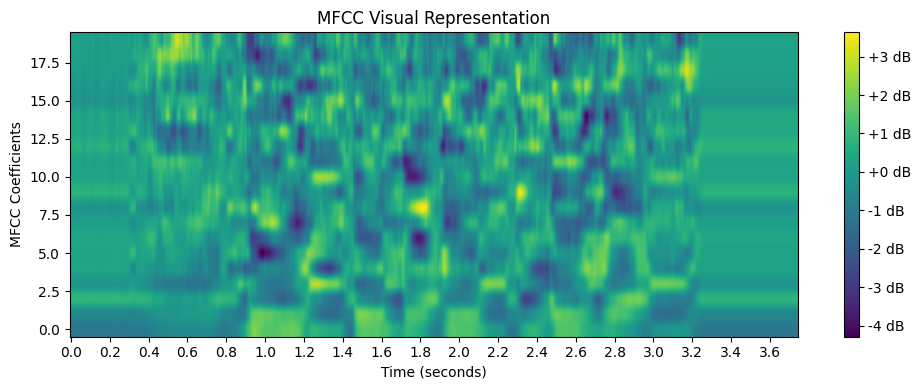

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_8397d036-9d12-4fd4-8bc8-44e66e3d08c8/final/chunk40.wav


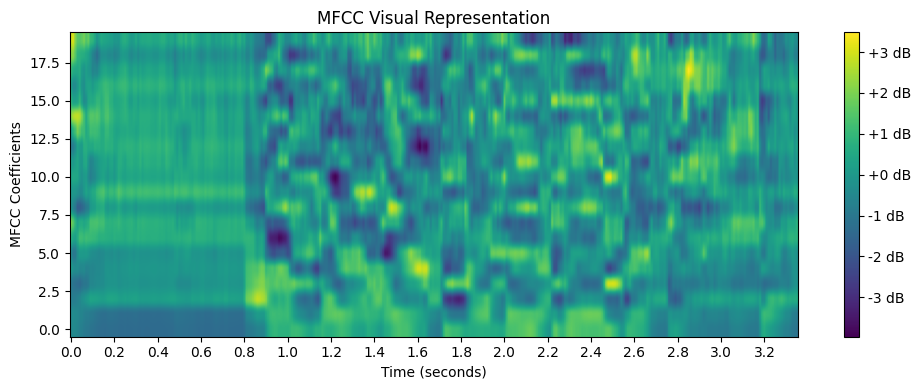

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_6dc69b7a-5d72-41db-9948-601edca00eda/final/chunk60.wav


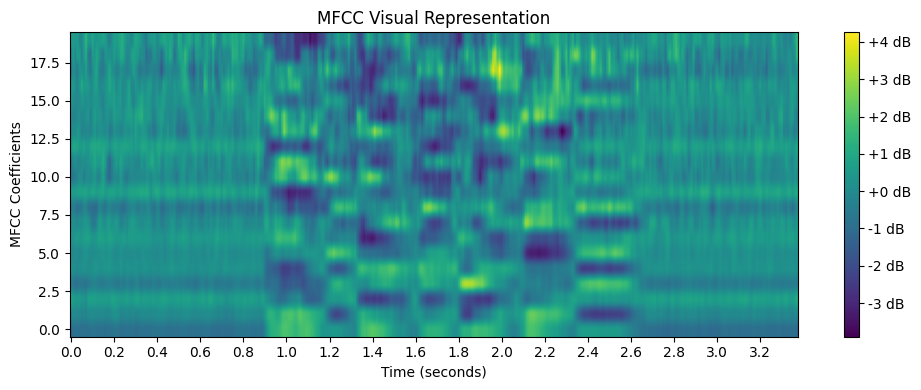

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_e6c2c5c8-cbab-4c40-aca0-b55a8041945c/final/chunk10.wav


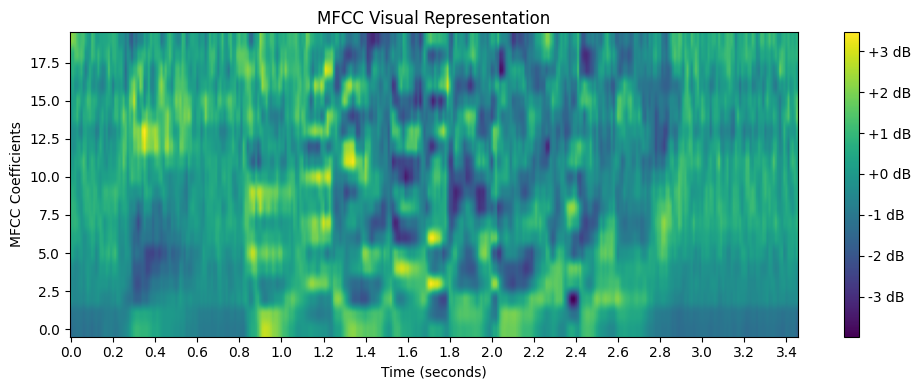

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_e5231ab4-6830-418f-8e7e-083bcd294503/final/chunk10.wav


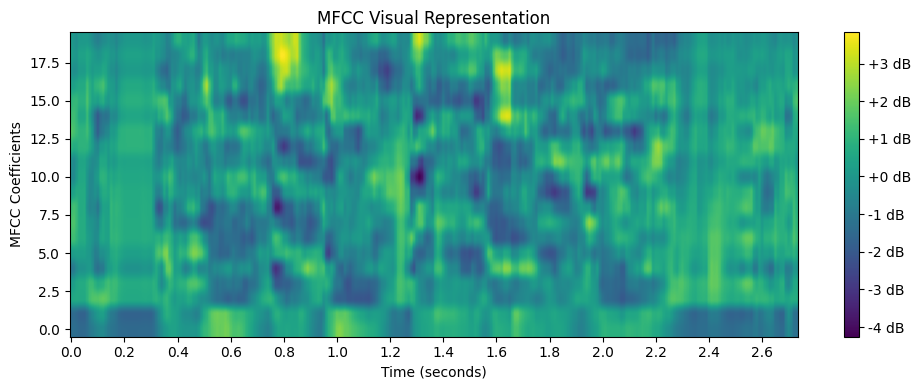

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_dab06789-4048-492d-82fa-fd0fc50cd6e6/final/chunk11.wav


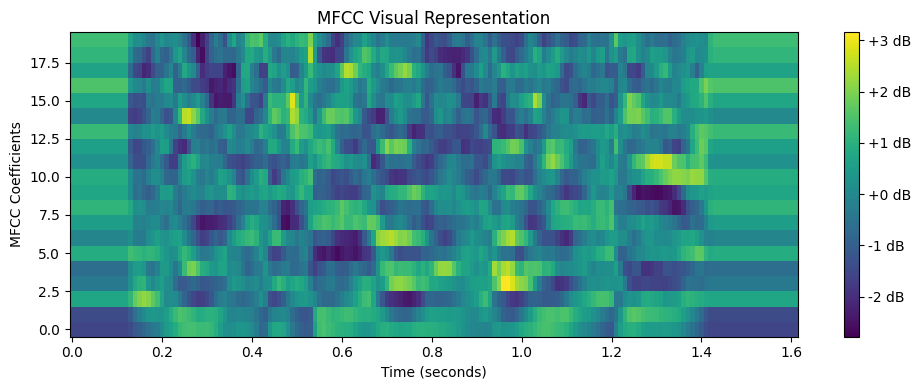

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_0fa8b085-a883-4aa2-a484-ec92481c08db/final/chunk00.wav


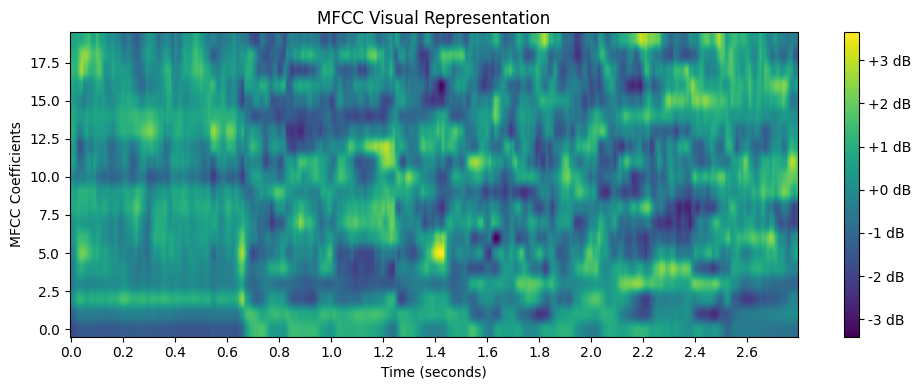

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_fae767fb-6308-4b1e-9818-71730554d3b9/final/chunk21.wav


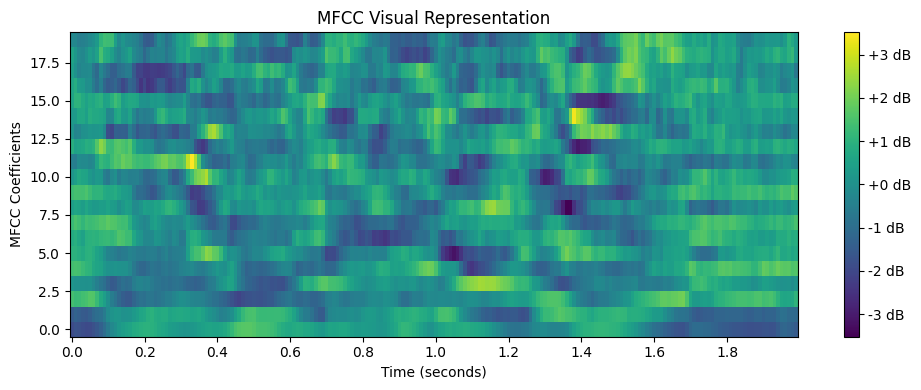

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_fc7be658-3b00-4f7b-88c4-0a7d9886822b/final/chunk40.wav


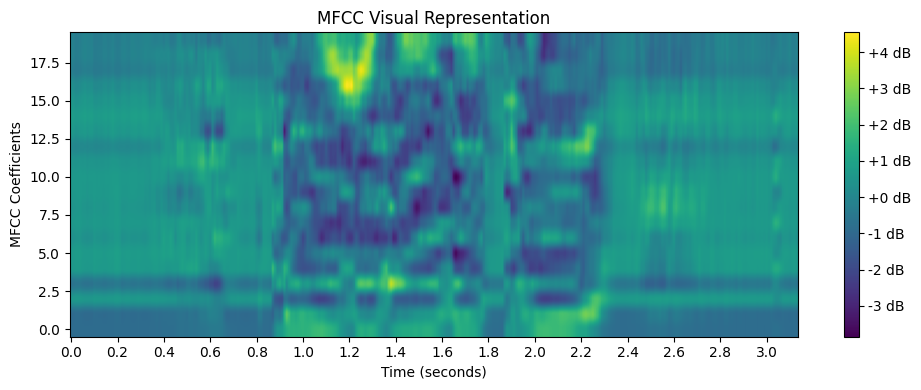

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_eb2218c1-664c-401f-833d-461bad55d39a/final/chunk11.wav


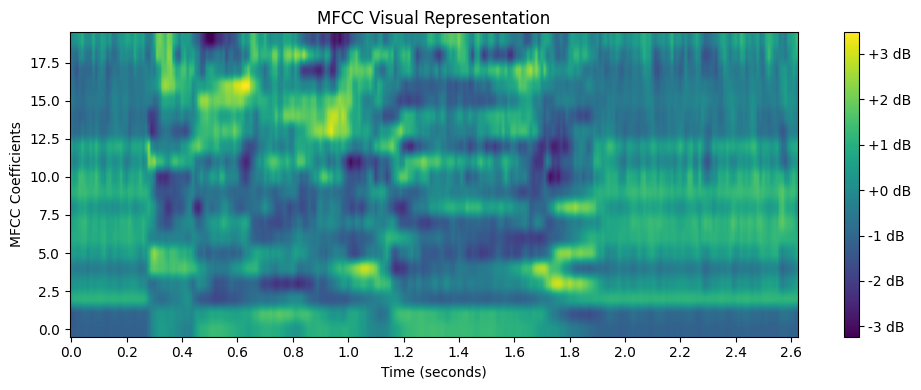

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_1f0adbb3-f94f-465a-a8b8-121f1e37e22a/final/chunk11.wav


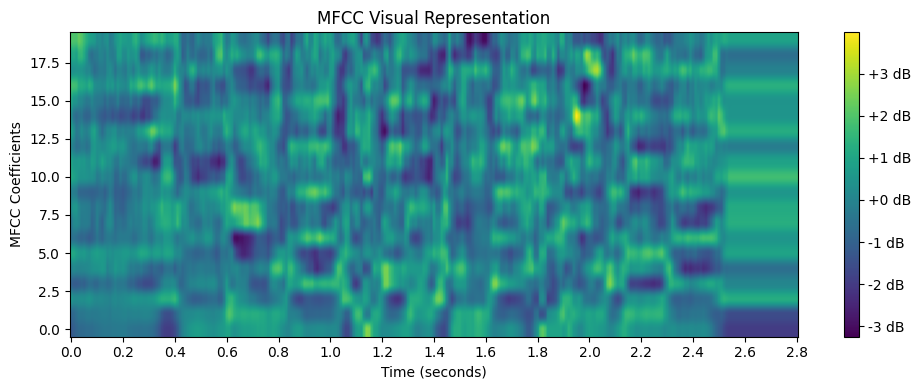

/content/drive/MyDrive/CMPT419/final_project/media/data/shout-data/shout_data_a60eb88b-1bdd-4f35-9c8c-fcfaf840dd0d/final/chunk41.wav


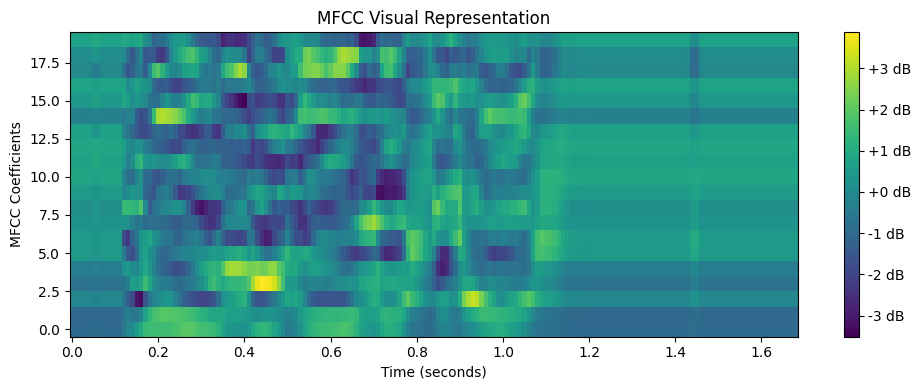

Test MFCC size:  100 , shape: (100, 20, 680) sequence:  [[[-1.0761225  -1.07371    -1.0741994  ...  0.          0.
    0.        ]
  [-0.772496   -0.7672426  -0.7681752  ...  0.          0.
    0.        ]
  [ 0.8452795   0.8519038   0.85138726 ...  0.          0.
    0.        ]
  ...
  [ 0.6714735   0.72642744  0.6691027  ...  0.          0.
    0.        ]
  [ 0.41747713  0.4755809   0.42189783 ...  0.          0.
    0.        ]
  [ 0.6548474   0.67834705  0.6619944  ...  0.          0.
    0.        ]]

 [[-1.8617235  -1.8244396  -1.9137481  ...  0.          0.
    0.        ]
  [-1.8635383  -1.7872227  -1.731426   ...  0.          0.
    0.        ]
  [ 1.1082841   1.1068249   1.145026   ...  0.          0.
    0.        ]
  ...
  [-0.01706484 -0.18102883 -0.3552823  ...  0.          0.
    0.        ]
  [-0.01401662 -0.13353555 -0.01923126 ...  0.          0.
    0.        ]
  [-0.8212717  -0.99354374 -0.8648225  ...  0.          0.
    0.        ]]

 [[-0.86177945 -0.86177945 -

In [7]:
############################################## start of file and path processing ##############################################

# reads the csv
# test_data = pd.read_csv("/content/drive/MyDrive/CMPT419/final_project/test_data.csv")
# uncommend if using direct file path
test_data = pd.read_csv("test_data.csv")
# print(test_data)

# get the path for wav file
test_data.loc[:, 'file_name'] = test_data['file_name'].str.replace('.wav', '')
csv_combined_wave_path = test_data['file_name'] + test_data['chunk_name']
# print("combined wave paths before to list: ", csv_combined_wave_path)

# all the wave files in the csv
csv_combined_wave_path = csv_combined_wave_path.tolist()
# print("combined wave paths: ", csv_combined_wave_path)

# use a dictionary to store the csv path and the wave path since they are different when using mounted google drive
path_dict = {}
for i in range(len(csv_combined_wave_path)):
  path_dict[csv_combined_wave_path[i]] = "/content/drive/MyDrive/CMPT419/final_project" + csv_combined_wave_path[i]
# print(path_dict)

############################################## end of file and path processing ##############################################

mfcc_test = []

mfcc_test = [extract_mfcc(path_dict[file_path]) for file_path in csv_combined_wave_path]

# can use mfcc_test to train model below
mfcc_test = np.array(mfcc_test)

print("Test MFCC size: ", len(mfcc_test), ", shape:", mfcc_test.shape, "sequence: ", mfcc_test)

np.save('mfccs_test.npy', mfcc_test)


Train the RNN

The RNN model is trained with 6 layers for a basic implementation. It uses LSTM layers to retain memory from previous sequential data.



In [10]:
# import again so easier to run this section independently
import numpy as np
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, classification_report
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, Bidirectional, BatchNormalization
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Adam

# load the data
# training_data = pd.read_csv("/content/drive/MyDrive/CMPT419/final_project/filtered_training_data.csv")
# test_data = pd.read_csv("/content/drive/MyDrive/CMPT419/final_project/test_data.csv")
# uncomment if using direct file path
training_data = pd.read_csv("filtered_training_data.csv")
test_data = pd.read_csv("test_data.csv")

# use mfcc from above
X_train = mfcc_train
X_test = mfcc_test

# encode the y values
label_encoder = LabelEncoder()
y_train = label_encoder.fit_transform(training_data['affect'])
# y_test = label_encoder.transform(test_data['affect']) # used to test against affect in test data
y_test = label_encoder.transform(test_data['perceived emotion'])

# one-hot encode the labels
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

# split into training set and a validation set
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

# define the model
model = Sequential()
model.add(LSTM(128, input_shape=(X_train.shape[1], X_train.shape[2]), return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(64))
model.add(Dense(64, activation='relu'))
model.add(BatchNormalization())
model.add(Dense(y_train.shape[1], activation='softmax'))

# compile model with 'adam'
optimizer = Adam(learning_rate=0.001)
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

# train the model
history = model.fit(X_train, y_train, epochs=40, batch_size=50, validation_data=(X_val, y_val))

# evaluate the model
loss, accuracy = model.evaluate(X_test, y_test)
print(f'Test Loss: {loss}, Test Accuracy: {accuracy}')

# convert predicted probabilities to labels to test
y_pred_prob = model.predict(X_test)
y_pred = np.argmax(y_pred_prob, axis=1)

# evaluate against 'perceived emotions'
perceived_emotions = test_data['perceived emotion']
perceived_emotions = label_encoder.transform(perceived_emotions)

# get f1 score and accuracy
f1 = f1_score(perceived_emotions, y_pred, average='weighted')
accuracy = accuracy_score(perceived_emotions, y_pred)
print(f'F1 Score for Perceived Emotions on RNN: {f1}')
print(f'Accuracy for Perceived Emotions on RNN: {accuracy}')

# display confusion matrix
conf_matrix = confusion_matrix(perceived_emotions, y_pred)
print('Confusion Matrix for Perceived Emotions on RNN:')
print(conf_matrix)

# show classification report
print('Classification Report for Perceived Emotions on RNN:')
print(classification_report(perceived_emotions, y_pred))

Epoch 1/40
48/48 [==============================] - 13s 146ms/step - loss: 2.1718 - accuracy: 0.1537 - val_loss: 1.9464 - val_accuracy: 0.1607
Epoch 2/40
48/48 [==============================] - 5s 105ms/step - loss: 1.7637 - accuracy: 0.2938 - val_loss: 1.9379 - val_accuracy: 0.1557
Epoch 3/40
48/48 [==============================] - 7s 140ms/step - loss: 1.5294 - accuracy: 0.4356 - val_loss: 1.9240 - val_accuracy: 0.1912
Epoch 4/40
48/48 [==============================] - 5s 101ms/step - loss: 1.2924 - accuracy: 0.5487 - val_loss: 1.9284 - val_accuracy: 0.2047
Epoch 5/40
48/48 [==============================] - 6s 129ms/step - loss: 1.0230 - accuracy: 0.6651 - val_loss: 1.9554 - val_accuracy: 0.1980
Epoch 6/40
48/48 [==============================] - 6s 116ms/step - loss: 0.8058 - accuracy: 0.7523 - val_loss: 1.9931 - val_accuracy: 0.2064
Epoch 7/40
48/48 [==============================] - 5s 99ms/step - loss: 0.5722 - accuracy: 0.8484 - val_loss: 2.0919 - val_accuracy: 0.2149
Epoch 

Below was my attempt at embedding and concatenating 'first_language', 'gender', and 'script' features with the MFCC features to use for training. It does not work.

There were issues with data size and I did not have the experience to reshape the feature data to match the MFCC shape. For future improvements, I would like to get this working and train the data with all the additional features. Having both the mfcc's as well as the other features could potentially give more context to the training model, and may yield interesting restults.

Sources:
*  https://stackoverflow.com/questions/61058494/embedding-and-concatenate-tensorflow-keras
*  https://www.kaggle.com/code/colinmorris/embedding-layers
*  https://www.hopsworks.ai/post/machine-learning-embeddings-as-features-for-models

In [ ]:
# # load the data
# training_data = pd.read_csv("/content/drive/MyDrive/CMPT419/final_project/filtered_training_data.csv")
# test_data = pd.read_csv("/content/drive/MyDrive/CMPT419/final_project/test_data.csv")

# encode X label variables
le = LabelEncoder()
first_language_train = le.fit_transform(training_data['first_language'])
gender_train = le.fit_transform(training_data['gender'])
script_train = le.fit_transform(training_data['script'])

first_language_test = le.fit_transform(test_data['first_language'])
gender_test = le.fit_transform(test_data['gender'])
script_test = le.fit_transform(test_data['script'])

# y train/test
y_train = le.fit_transform(training_data['affect'])
y_test = le.fit_transform(test_data['affect'])

# split the training data into a training set and a validation set
X_train, X_val, first_language_train, first_language_val, gender_train, gender_val, script_train, script_val, y_train, y_val = train_test_split(mfcc_train, first_language_train, gender_train, script_train, y_train, test_size=0.2, random_state=42)

# define embeddings
input_numeric = Input(shape=(mfcc_train.shape[1],))
input_first_language = Input(shape=(1,))
input_gender = Input(shape=(1,))
input_script = Input(shape=(1,))

# generate 1-hot vector (english is 100, french 010 etc)
# or I can use number to represent them

embedding_first_language = Embedding(input_dim=np.max(first_language_train) + 1, output_dim=50)(input_first_language)
embedding_gender = Embedding(input_dim=np.max(gender_train) + 1, output_dim=50)(input_gender)
embedding_script = Embedding(input_dim=np.max(script_train) + 1, output_dim=50)(input_script)

# concatenate the expanded MFCC input with the embeddings
x = concatenate([input_numeric, Flatten()(embedding_first_language), Flatten()(embedding_gender), Flatten()(embedding_script)])
x = tf.expand_dims(x, axis=1)

# define LSTM layers and subsequent layers
x = LSTM(128, activation='relu', return_sequences=True)(x)
x = Dropout(0.2)(x)
x = LSTM(128, activation='relu')(x)
x = Dropout(0.2)(x)
x = Dense(32, activation='relu')(x)
x = Dropout(0.2)(x)
output = Dense(np.max(y_train) + 1, activation='softmax')(x)

model = Model(inputs=[input_numeric, input_first_language, input_gender, input_script], outputs=output)

# compile and train the model
model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
model.fit([X_train, first_language_train, gender_train, script_train], y_train, epochs=30, validation_data=([X_val, first_language_val, gender_val, script_val], y_val))

# test results
y_pred = model.predict([mfcc_test, first_language_test, gender_test, script_test])
y_pred = np.argmax(y_pred, axis=1)

print('\nTest accuracy:', accuracy_score(y_test, y_pred))
print('F1 score:', f1_score(y_test, y_pred, average='weighted'))
print('Confusion Matrix:\n', confusion_matrix(y_test, y_pred))